## Overview

This notebook is set to create social ratings on a circular rating scale

- load circular rating image
- select a mean High or Low rating
- select a standard deviation
- splash random dots based on the mean + sd
- save image

## import libraries

In [1]:
# Python program to read  
# image using matplotlib 
  
# importing matplotlib modules 
import os, shutil
import matplotlib.image as mpimg 
import matplotlib.pyplot as plt 
import matplotlib as mpl
from matplotlib.path import Path
import matplotlib.patches as patches
import math
from math import pi, cos, sin, sqrt
import random
import numpy as np
import pandas as pd
from scipy.stats import loggamma
from scipy.stats import johnsonsu
from scipy.stats import beta

%matplotlib inline

## functions : display image in actual size

In [2]:
def display_image_in_actual_size(im_path):

    dpi = mpl.rcParams['figure.dpi']
    im_data = plt.imread(im_path)
    height, width, depth = im_data.shape

    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()

## parameters

In [3]:
main_dir = '/Users/h/Documents/projects_local/social_influence'

## scale example

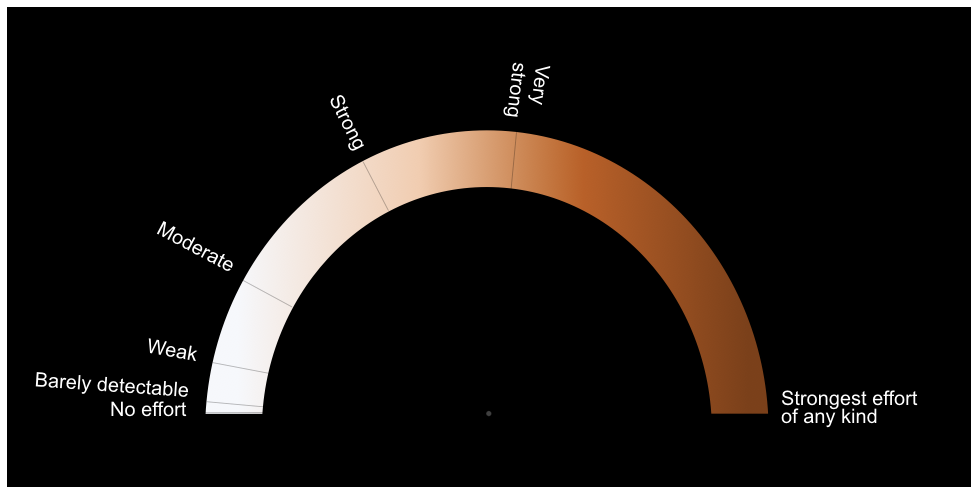

In [4]:
condition = 'cognitive'
img_scale = os.sep.join([main_dir, 'stimuli', 'ratingscale', 'task-'+ condition + '_scale.png'])
display_image_in_actual_size(img_scale)

# after fitting it to the pilot data

* Sep 2019
* We ran 5 particpants and fitted the rating distribution of the mental rotation task. 
* loggamma(c = 0.17, loc = 177.11, scale = 2.22)

* beta 
* low(2930.02, -0.008, 0.002)
* med (3020.52, -0.08, 0.005, )
* high (0.158, 36.56, 27.94)

In [5]:
def make_pdf(dist, params, size=10000):
    """Generate distributions's Probability Distribution Function """

    # Separate parts of parameters
    arg = params[:-2]
    loc = params[-2]
    scale = params[-1]

    # Get sane start and end points of distribution
    start = dist.ppf(0.01, *arg, loc=loc, scale=scale) if arg else dist.ppf(0.01, loc=loc, scale=scale)
    end = dist.ppf(0.99, *arg, loc=loc, scale=scale) if arg else dist.ppf(0.99, loc=loc, scale=scale)

    # Build PDF and turn into pandas Series
    x = np.linspace(start, end, size)
    y = dist.pdf(x, loc=loc, scale=scale, *arg)
    pdf = pd.Series(y, x)

    return pdf



## Beta low

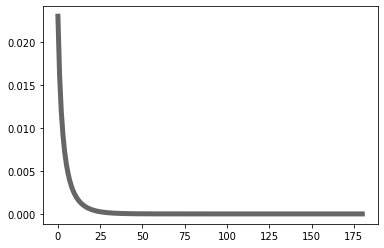

In [6]:
# low(0.108, 230.56, -2.89, 2140.63)
# med (0.332, 0.983, -1.814, 128.301)
# high (0.878, 0.699, -4,59, 93.915)
x = np.arange(0,181)
fig, ax = plt.subplots(1, 1)
ax.plot(x, beta.pdf(x,0.1, 200, -3, 2000), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

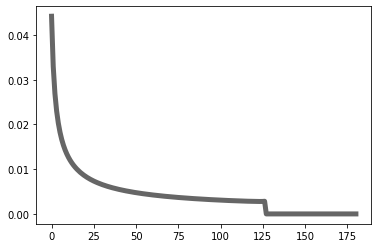

In [7]:
# low(0.108, 230.56, -2.89, 2140.63)
# med (0.332, 0.983, -1.814, 128.301)
# high (0.878, 0.699, -4,59, 93.915)
x = np.arange(0,181)
fig, ax = plt.subplots(1, 1)
ax.plot(x, beta.pdf(x,0.332, 0.983, -1.814, 128.301), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

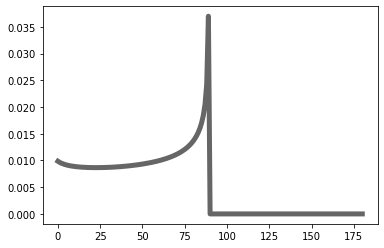

In [8]:
# low(0.108, 230.56, -2.89, 2140.63)
# med (0.332, 0.983, -1.814, 128.301)
# high (0.878, 0.699, -4,59, 93.915)
x = np.arange(0,181)
fig, ax = plt.subplots(1, 1)
ax.plot(x, beta.pdf(x,0.878, 0.699, -4.59, 93.915), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

# plot high med low 

(array([1., 0., 0., 0., 0., 1., 0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 1., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
 array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.

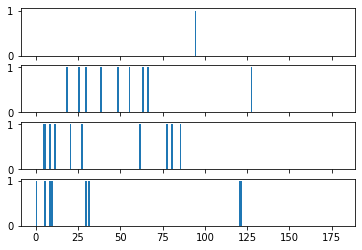

In [9]:
# low(0.108, 230.56, -2.89, 0)
# med (0.332, 0.983, -1.814, 128.301)
# high (0.878, 0.699, -4,59, 93.915)

x = 0;y = 180
# low = x + (np.random.beta(a = 0.1,b = 2, size = 10) * (y - x))
# med = x + (np.random.beta(a = 0.4,b = 0.99, size = 10) * (y - x))
# high = x + (np.random.beta(a = 0.8,b = 0.7, size = 10) * (y - x))
# mixture = x + (np.random.beta(a = 0.6,b = 0.85, size = 10) * (y - x))


low = beta.rvs(a = 0.1,b = 2,loc = -2.89,scale = 180,size = 10)
med = beta.rvs(a = 0.4,b = 0.99,loc = -1.81,scale = 130,size = 10)
high = beta.rvs(a = 0.8,b = 0.7,loc = -4.59,scale = 90,size = 10)
mixture = beta.rvs(a = 0.6,b = 0.85,loc = -3.2,scale = 130,size = 10)

fig, ax = plt.subplots(4, sharex=True, sharey=True)
ax[0].hist(low, bins = np.linspace(0,180,181))
ax[1].hist(med, bins = np.linspace(0,180,181))
ax[2].hist(high, bins = np.linspace(0,180,181))
ax[3].hist(mixture, bins = np.linspace(0,180,181))

In [10]:
# beta.rvs(a = 0.8,b = 0.7,scale = 180,size = 10)
mean, var, skew, kurt = beta.stats(a = 0.1,b = 2, moments='mvsk')
print(mean, var, skew, kurt)

0.047619047619047616 0.01462950771706532 3.6489304782005956 14.879483500717361


* iteratively create low med high distributions
* these values are thetas
* plot them into the circular rating space

In [11]:
beta.rvs(a = 0.1,b = 2,loc = 0,scale = 180,size = 10)

array([4.24011781e-01, 6.30273797e-10, 2.79576575e-07, 3.15014672e-04,
       1.35148142e+00, 2.32662725e-04, 2.27486950e-03, 8.64546980e-05,
       6.36706873e+00, 6.30284484e+01])

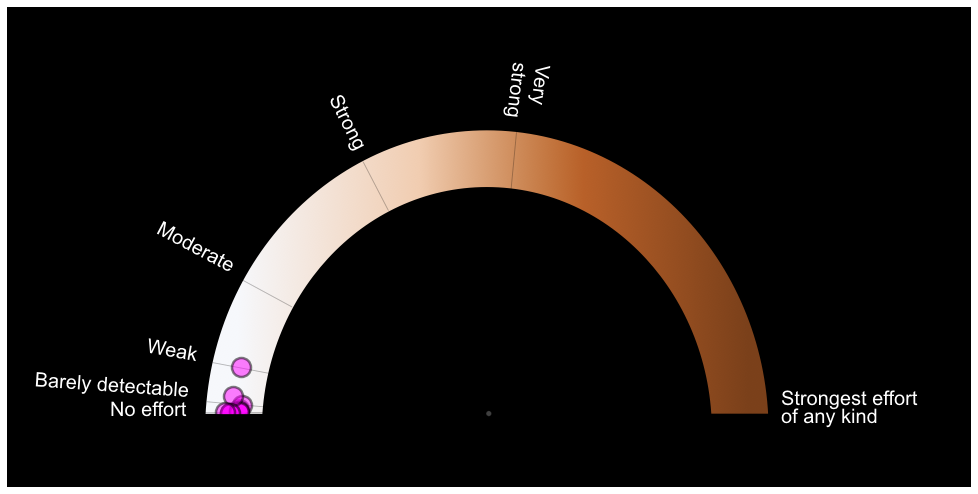

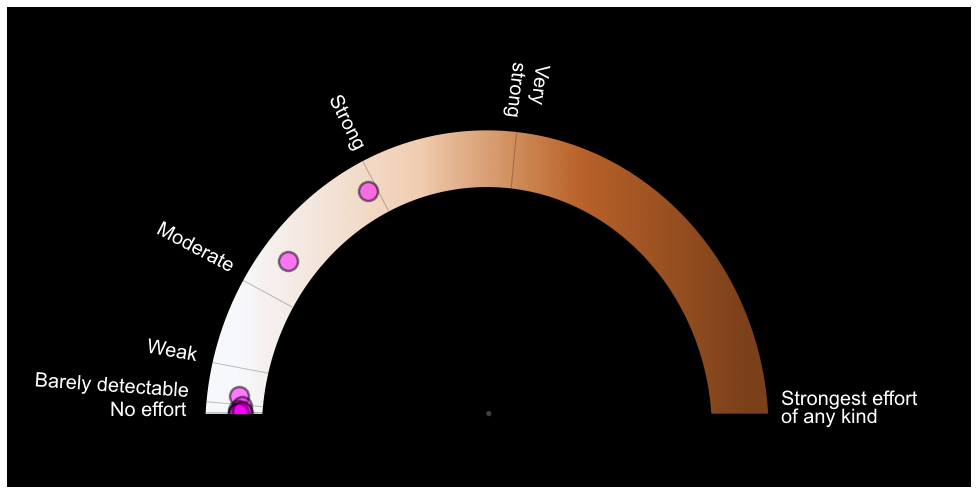

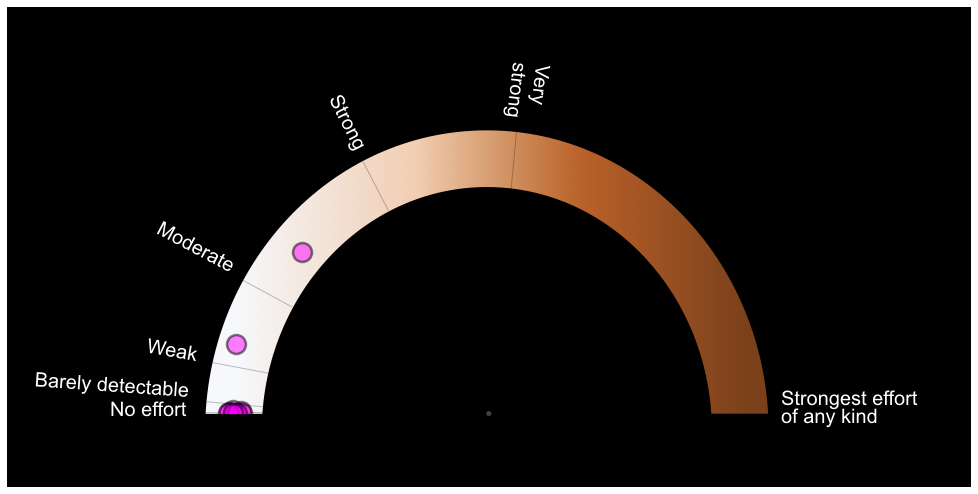

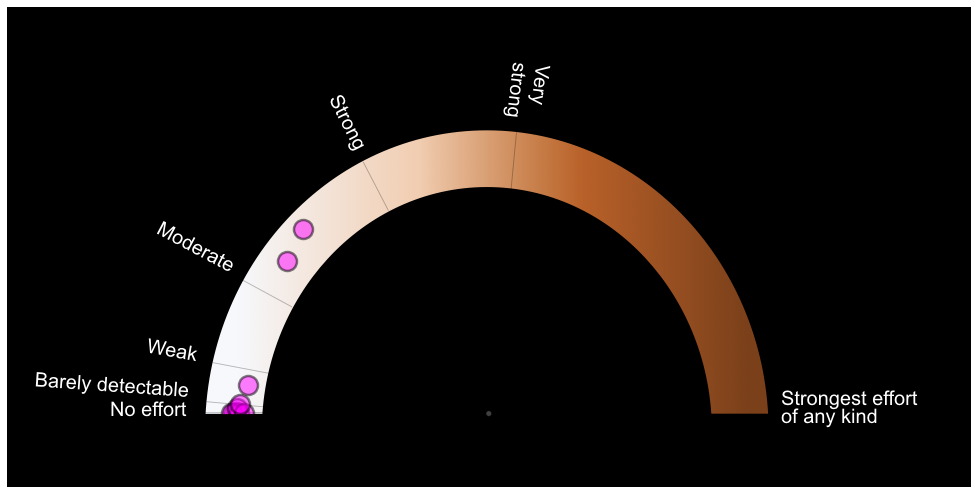

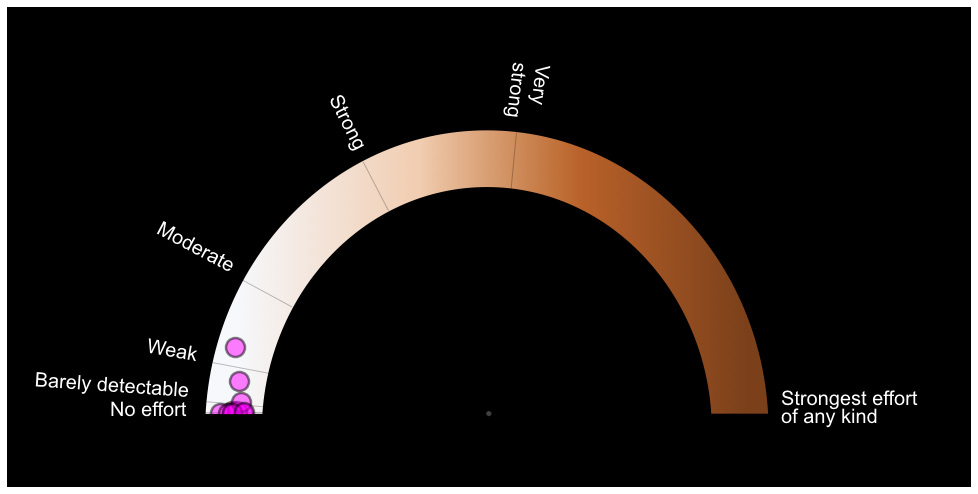

...

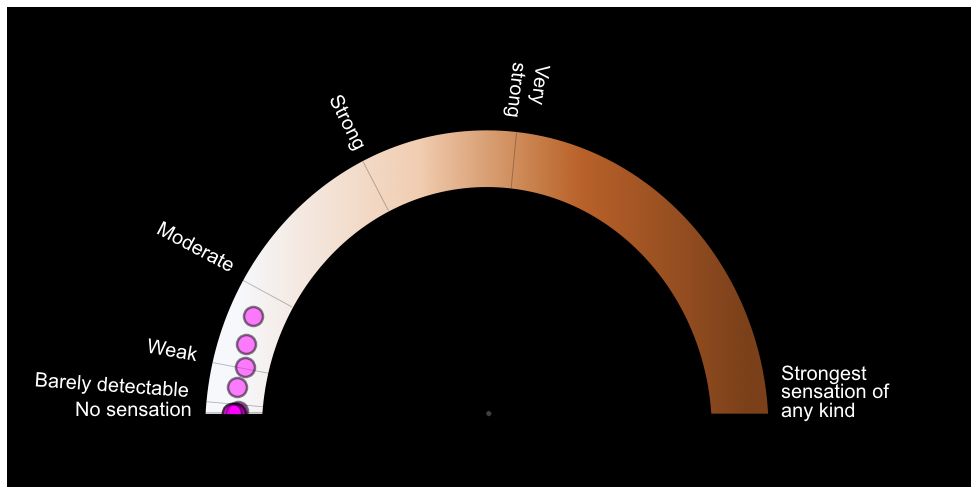

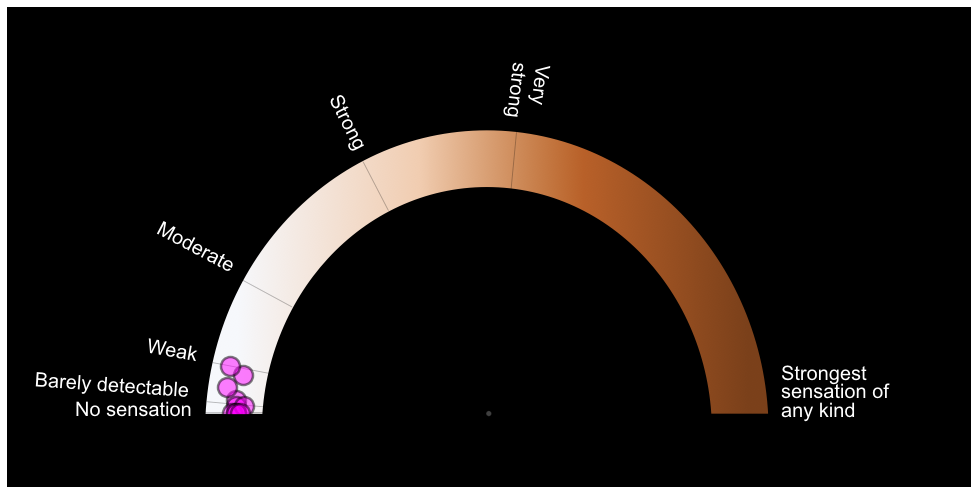

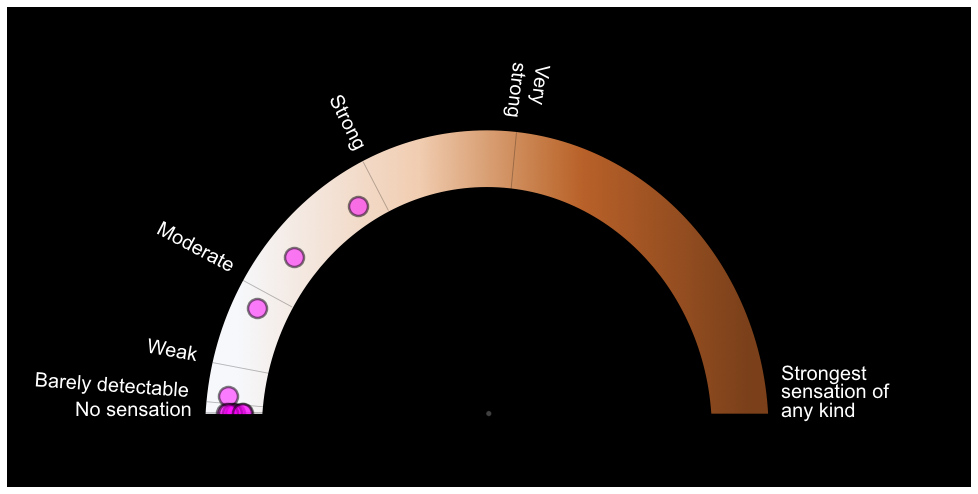

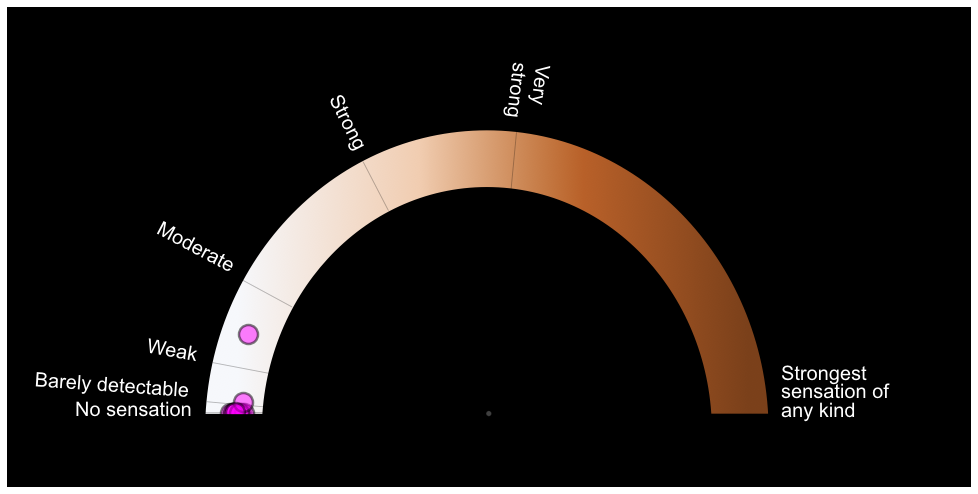

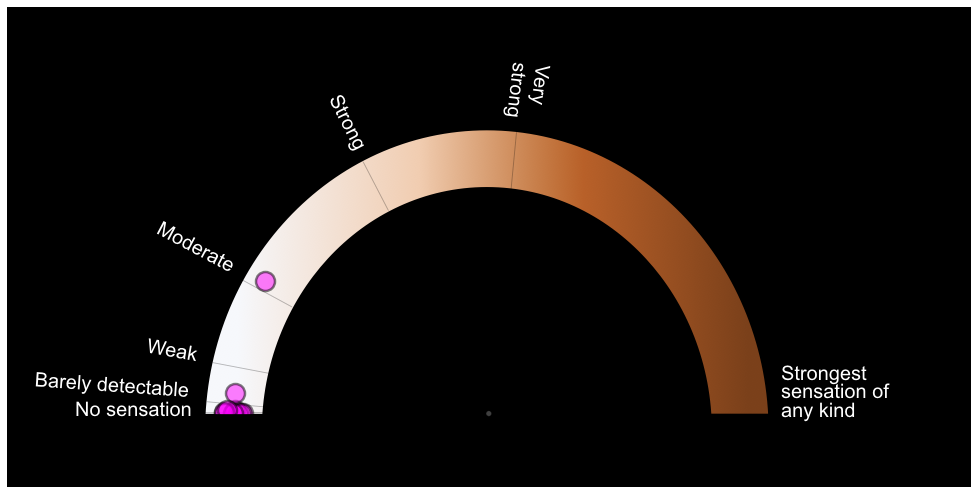

In [21]:
# low = beta.rvs(a = 0.1,b = 2,loc = -2.89,scale = 180,size = 10)
# med = beta.rvs(a = 0.4,b = 0.99,loc = -1.81,scale = 130,size = 10)
# high = beta.rvs(a = 0.8,b = 0.7,loc = -4.59,scale = 90,size = 10)
# mixture = beta.rvs(a = 0.6,b = 0.85,loc = -3.2,scale = 130,size = 10)
condition_list = ['cognitive', 'pain', 'vicarious']

for ind, condition in enumerate(condition_list):
    low_dir = os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'scl'])
    img_scale = os.sep.join([main_dir, 'stimuli', 'ratingscale', 'task-'+ condition + '_scale.png'])
    centerX = 480
    centerY = 406
    for fignum in range(1,57):
        low_sample = beta.rvs(a = 0.1,b = 2,loc = 0,scale = 90,size = 10)
        # dist = x + (np.random.beta(a = 0.6,b = 0.85, size = 10) * (y - x))
        # display_image_in_actual_size(img_scale)
        dpi = mpl.rcParams['figure.dpi']
        im_data = plt.imread(img_scale)
        height, width, depth = im_data.shape

        # What size does the figure need to be in inches to fit the image?
        figsize = width / float(dpi), height / float(dpi)

        # Create a figure of the right size with one axes that takes up the full figure
        fig = plt.figure(figsize=figsize)
        ax = fig.add_axes([0, 0, 1, 1])
        ax.axis('off') # Hide spines, ticks, etc. 
        ax.imshow(im_data, cmap='gray')  # Display the image.


        sample_data = pd.DataFrame()
        col_name = []
        col_name = 'figure' + '{:03d}'.format(fignum)
        sample_data[col_name] = low_sample


        mu, sigma = 0, 5 # mean and standard deviation
        s = np.random.normal(mu, sigma, 10)
        sample_data['theta'] = abs(180 - low_sample)
        sample_data['r'] = 253 + s
        sample_data['x'] = centerX+sample_data['r'] * np.cos(sample_data['theta']*(math.pi/180)) 
        sample_data['y'] = centerY-sample_data['r'] * np.sin(sample_data['theta']*(math.pi/180)) 
        sample_data['newr'] = np.ones(sample_data.r.shape)
        area = 200 * sample_data['newr']**2
        ax.scatter( sample_data['x'], sample_data['y'],s=19**2, c='Magenta', alpha=.5, edgecolors='black', linewidths=2.5)

        # add square to hide circles that go outside of the scale
#         https://matplotlib.org/1.3.1/users/path_tutorial.html
        verts = [
            (200., 480.), # left, bottom
            (200., 408.), # left, top
            (300., 408.), # right, top
            (300., 480.), # right, bottom
            (0., 0.), # ignored
            ]
        codes = [Path.MOVETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.CLOSEPOLY,
                 ]

        path = Path(verts, codes)
        patch = patches.PathPatch(path, facecolor='black', lw=1.7)
        # patch = patches.PathPatch(path, facecolor='orange', lw=2)
        ax.add_patch(patch)
        # ax.scatter(centerX,centerY,c='blue' ,s = 3**2)
        plt.show()


        # save file
                # save image
        file_name = 'l' + '{:03d}'.format(fignum)  + '.png'
        file_fullname = os.path.join(low_dir, file_name)
        fig.savefig(file_fullname)

        # save pd dataframe
    sample_data.rename(index={0:'s01',1:'s02',2:'s03',3:'s04',4:'s05',5:'s06',6:'s07',7:'s08',8:'s09',9:'s10'}, inplace=True) 
#     sample_data.loc['sample_mean'] = sample_data.mean()
#     sample_data.loc['sample_std'] = sample_data.std()
    sample_data.to_csv(os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'scl_data.csv']))




# ----------------
# ax = fig.add_subplot(111, projection='polar')

# groups = result.groupby('administer')
# ax = plt.figure(figsize=(20, 10))
# ax = fig.add_subplot(projection='polar')
# ax.set_thetamin(0)
# ax.set_thetamax(180)

# ax.scatter(result['theta'].to_numpy(), result['r'].to_numpy(), c='red', s=15**2, cmap='hsv', alpha=0.5)

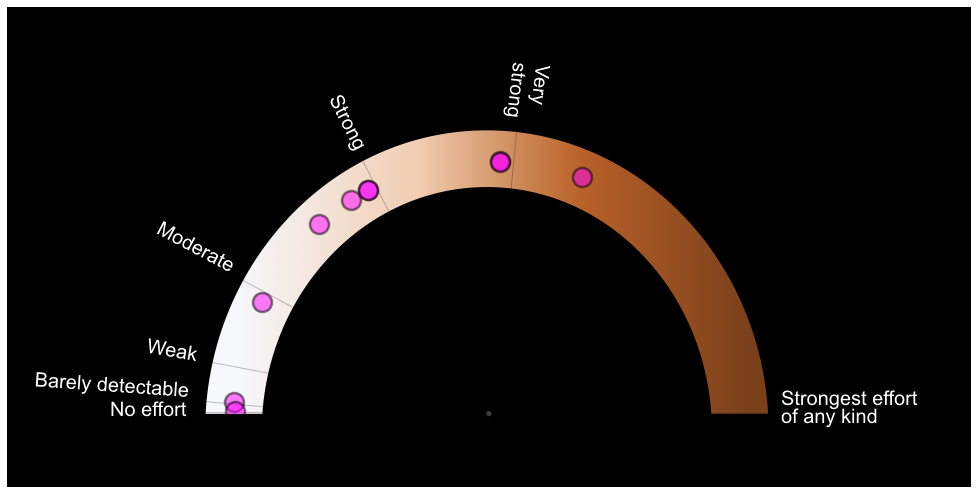

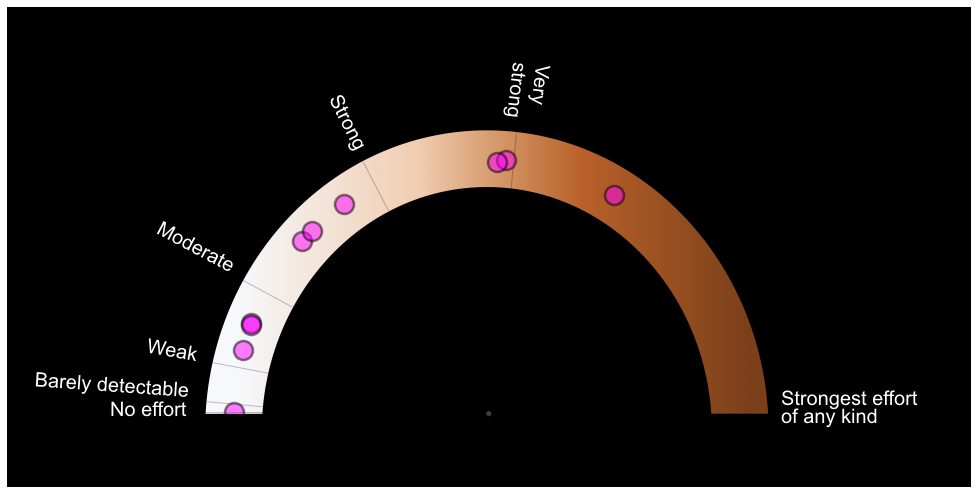

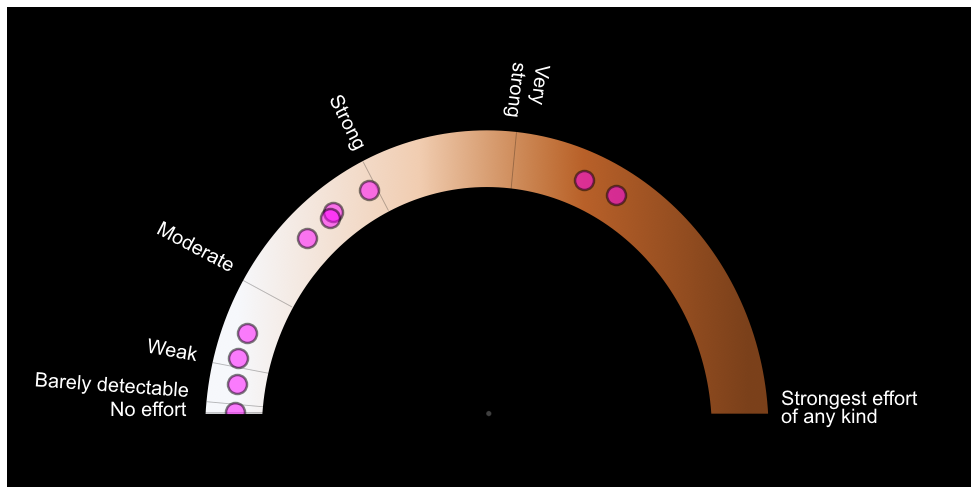

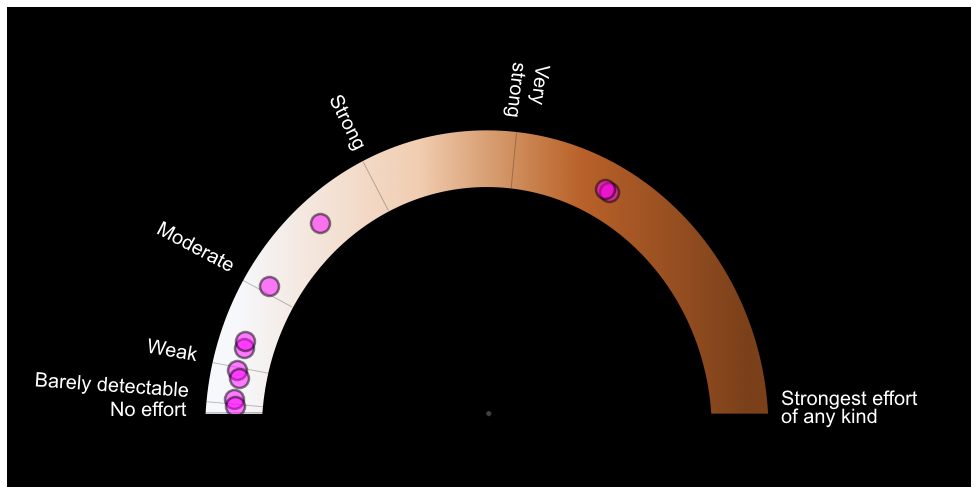

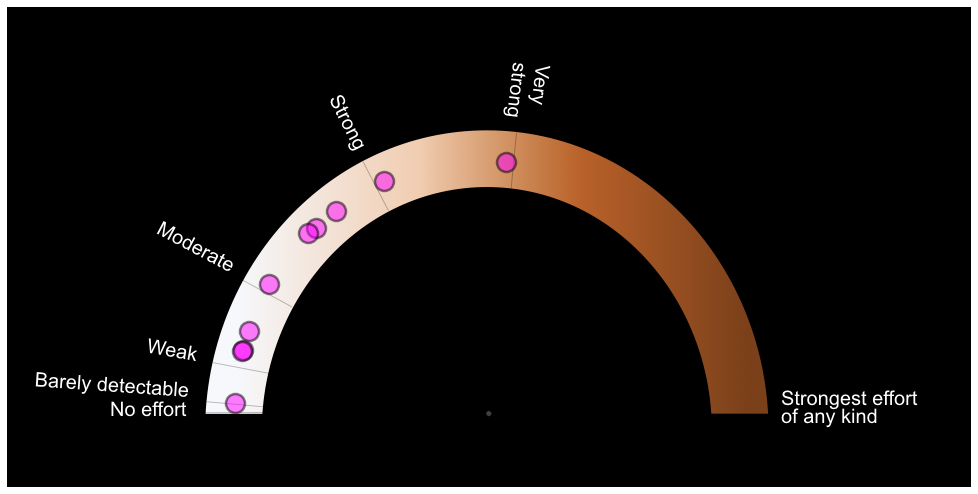

...

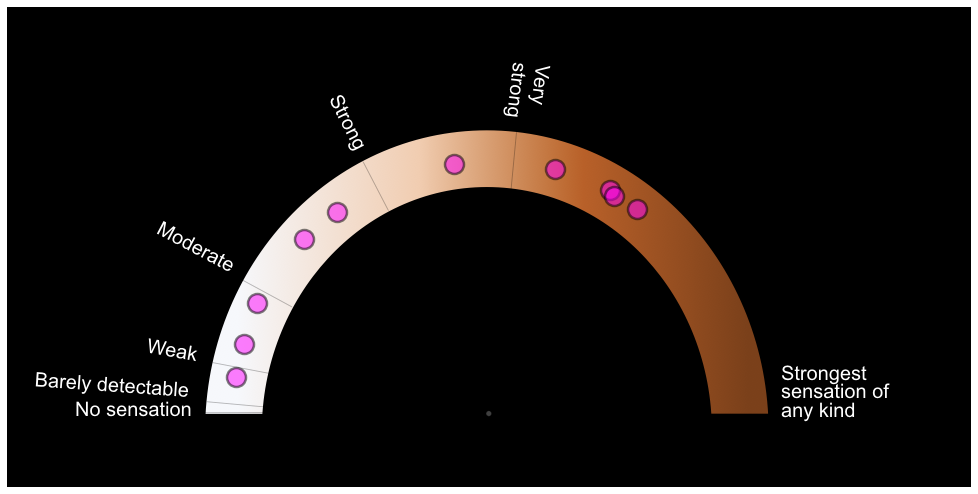

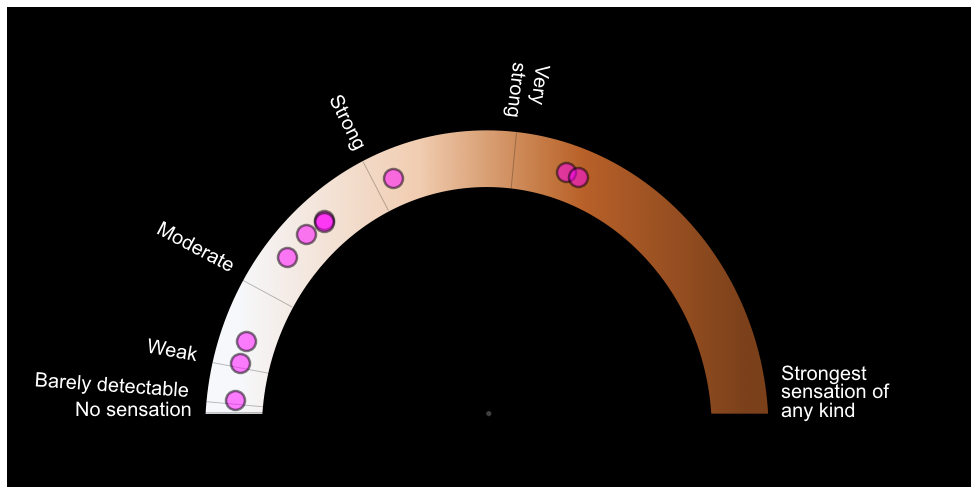

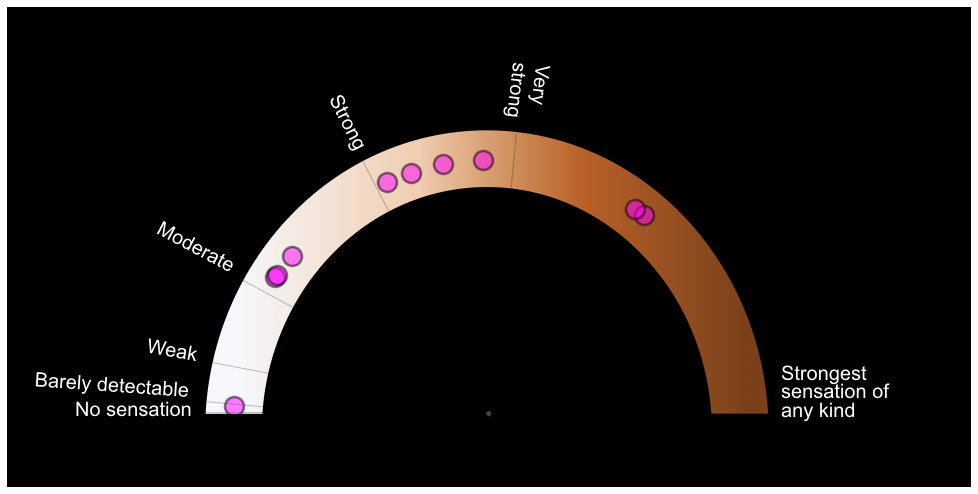

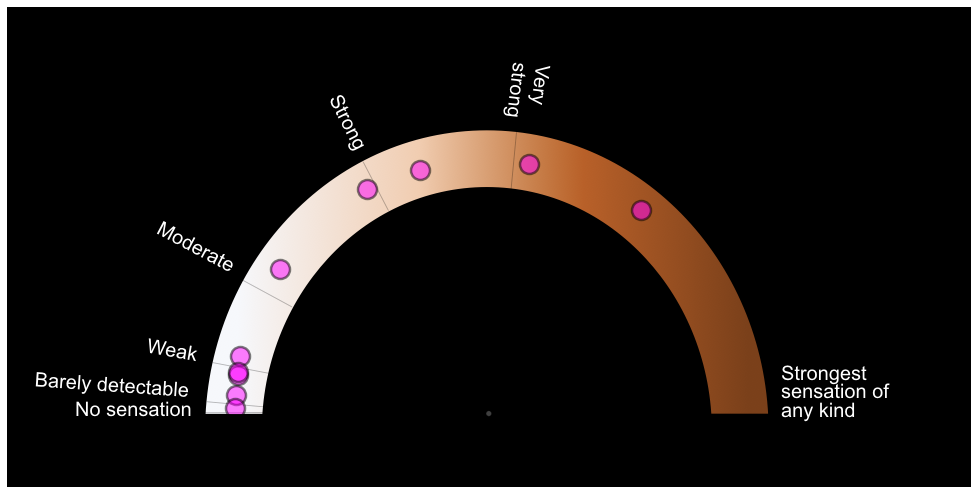

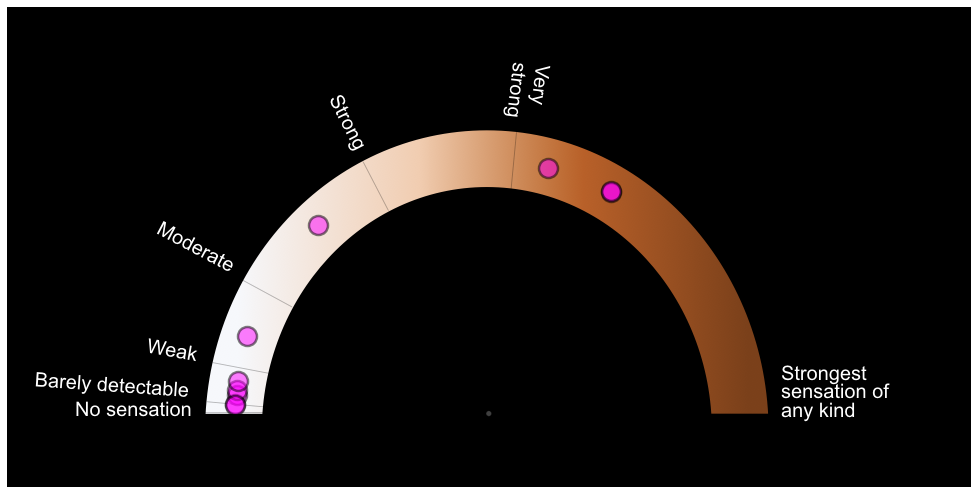

In [22]:
# low = beta.rvs(a = 0.1,b = 2,loc = -2.89,scale = 180,size = 10)
# med = beta.rvs(a = 0.4,b = 0.99,loc = -1.81,scale = 130,size = 10)
# high = beta.rvs(a = 0.8,b = 0.7,loc = -4.59,scale = 90,size = 10)
# mixture = beta.rvs(a = 0.6,b = 0.85,loc = -3.2,scale = 130,size = 10)

condition_list = ['cognitive', 'pain', 'vicarious']

for ind, condition in enumerate(condition_list):
    high_dir = os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'sch'])
    img_scale = os.sep.join([main_dir, 'stimuli', 'ratingscale', 'task-'+ condition + '_scale.png'])
    centerX = 480
    centerY = 406
    for fignum in range(1,57):
        high_sample = beta.rvs(a = 0.6,b = 0.85,loc=0,scale = 130,size = 10)
        # dist = x + (np.random.beta(a = 0.6,b = 0.85, size = 10) * (y - x))
        # display_image_in_actual_size(img_scale)
        dpi = mpl.rcParams['figure.dpi']
        im_data = plt.imread(img_scale)
        height, width, depth = im_data.shape

        # What size does the figure need to be in inches to fit the image?
        figsize = width / float(dpi), height / float(dpi)

        # Create a figure of the right size with one axes that takes up the full figure
        fig = plt.figure(figsize=figsize)
        ax = fig.add_axes([0, 0, 1, 1])
        ax.axis('off') # Hide spines, ticks, etc. 
        ax.imshow(im_data, cmap='gray')  # Display the image.


        sample_data = pd.DataFrame()
        col_name = []
        col_name = 'figure' + '{:03d}'.format(fignum)
        sample_data[col_name] = high_sample


        mu, sigma = 0, 1 # mean and standard deviation
        s = np.random.normal(mu, sigma, 10)
        sample_data['theta'] = abs(180 - high_sample)
        sample_data['r'] = 253 + s
        sample_data['x'] = centerX+sample_data['r'] * np.cos(sample_data['theta']*(math.pi/180)) 
        sample_data['y'] = centerY-sample_data['r'] * np.sin(sample_data['theta']*(math.pi/180)) 
        sample_data['newr'] = np.ones(sample_data.r.shape)
        area = 200 * sample_data['newr']**2
        ax.scatter( sample_data['x'], sample_data['y'],s=19**2, c='Magenta', alpha=.5, edgecolors='black', linewidths=2.5)

        # add square to hide circles that go outside of the scale
#         https://matplotlib.org/1.3.1/users/path_tutorial.html
        verts = [
            (200., 480.), # left, bottom
            (200., 408.), # left, top
            (300., 408.), # right, top
            (300., 480.), # right, bottom
            (0., 0.), # ignored
            ]
        codes = [Path.MOVETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.CLOSEPOLY,
                 ]

        path = Path(verts, codes)
        patch = patches.PathPatch(path, facecolor='black', lw=1.7)
        # patch = patches.PathPatch(path, facecolor='orange', lw=2)
        ax.add_patch(patch)
        # ax.scatter(centerX,centerY,c='blue' ,s = 3**2)
        plt.show()


        # save file
                # save image
        file_name = 'h' + '{:03d}'.format(fignum)  + '.png'
        file_fullname = os.path.join(high_dir, file_name)
        fig.savefig(file_fullname)

        # save pd dataframe
    sample_data.rename(index={0:'s01',1:'s02',2:'s03',3:'s04',4:'s05',5:'s06',6:'s07',7:'s08',8:'s09',9:'s10'}, inplace=True) 
#     sample_data.loc['sample_mean'] = sample_data.mean()
#     sample_data.loc['sample_std'] = sample_data.std()
    sample_data.to_csv(os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'sch_data.csv']))




# ----------------
# ax = fig.add_subplot(111, projection='polar')

# groups = result.groupby('administer')
# ax = plt.figure(figsize=(20, 10))
# ax = fig.add_subplot(projection='polar')
# ax.set_thetamin(0)
# ax.set_thetamax(180)

# ax.scatter(result['theta'].to_numpy(), result['r'].to_numpy(), c='red', s=15**2, cmap='hsv', alpha=0.5)

# old analysis

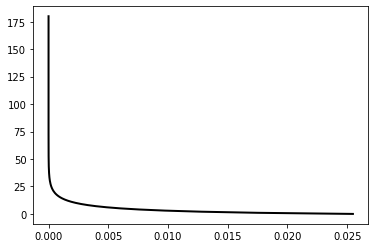

In [102]:
# rv.pdf(x)
fig, ax = plt.subplots(1, 1)
ax.plot( rv.pdf(x),x, 'k-', lw=2, label='frozen pdf')

In [100]:
rv.pdf(x)


array([2.54752030e-02, 1.75202176e-02, 1.28130560e-02, 9.73653801e-03,
       7.59500148e-03, 6.03831228e-03, 4.87057672e-03, 3.97350685e-03,
       3.27144260e-03, 2.71376717e-03, 2.26537989e-03, 1.90121692e-03,
       1.60294203e-03, 1.35686508e-03, 1.15258673e-03, 9.82089702e-04,
       8.39113681e-04, 7.18715591e-04, 6.16954247e-04, 5.30660195e-04,
       4.57265145e-04, 3.94673815e-04, 3.41166435e-04, 2.95323758e-04,
       2.55968795e-04, 2.22121124e-04, 1.92960775e-04, 1.67799451e-04,
       1.46057454e-04, 1.27245046e-04, 1.10947333e-04, 9.68119087e-05,
       8.45387339e-05, 7.38717887e-05, 6.45921683e-05, 5.65123471e-05,
       4.94713977e-05, 4.33309912e-05, 3.79720415e-05, 3.32918819e-05,
       2.92018824e-05, 2.56254346e-05, 2.24962432e-05, 1.97568738e-05,
       1.73575171e-05, 1.52549339e-05, 1.34115537e-05, 1.17947034e-05,
       1.03759449e-05, 9.13050727e-06, 8.03679762e-06, 7.07598031e-06,
       6.23161388e-06, 5.48933771e-06, 4.83660109e-06, 4.26242887e-06,
      

In [97]:
r = beta.rvs(0.108, 230.56, -2.89, 2140.63, size=1000)

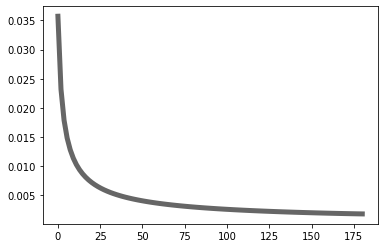

In [25]:
## low(0.108, 230.56, -2.89, 2140.63)
# med (0.332, 0.983, -1.814, 128.301)
# high (0.878, 0.699, -4,59, 93.915)
x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
ax.plot(x, beta.pdf(x,0.332, 0.983, -2, 200), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

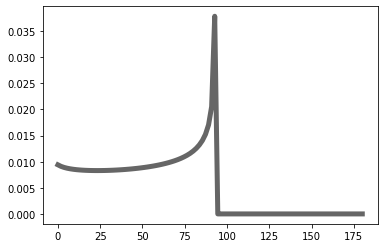

In [33]:
# low(0.108, 230.56, -2.89, 2140.63)
# med (0.332, 0.983, -1.814, 128.301)
# high (0.878, 0.699, -4,59, 93.915)
x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
ax.plot(x, beta.pdf(x,0.878, 0.699, -5, 98), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

## johnsonsu low

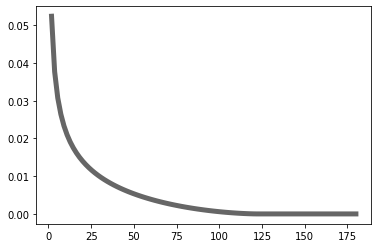

In [12]:
# johnsonsu
# loggammacombined data low
# low 5.74, 0.877, 180.82, 0.019
# (6.064444072172332,
#  1.0514702513247631,
#  183.13906303642042,
#  0.17941739969742476)

x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
# 0.56 2.62 loc 0 scale 122.47
# (c = 0.17, loc = 177.11, scale = 2.22)
# dist_low = beta.pdf(x,6.064444072172332, 1.0514702513247631, 183.13906303642042, 0.17941739969742476)
ax.plot(x, beta.pdf(x,0.56, 2.62, 0,122.47), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

In [91]:
# random sdelect
np.random.choice(dist_low, 10, replace=True)

array([0.0016449 , 0.01376694, 0.00113893, 0.00075426, 0.00109531,
       0.00113893, 0.0055524 , 0.00075426, 0.01957836, 0.00042559])

## johnsonsu med

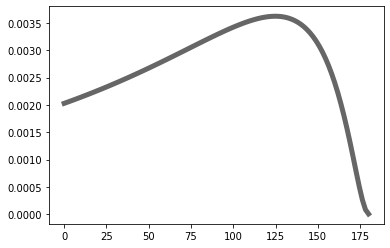

In [87]:
# johnsonsu
# loggammacombined data low
# low 5.74, 0.877, 180.82, 0.019
# (6.064444072172332,
#  1.0514702513247631,
#  183.13906303642042,
#  0.17941739969742476)

x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
# (c = 0.17, loc = 177.11, scale = 2.22)
johnsonsu.pdf(x,6.064444072172332, 1.0514702513247631, 183.13906303642042, 0.17941739969742476)
ax.plot(x, johnsonsu.pdf(x,5.90, 0.92, 181, 0.6), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

## johnson su high

In [89]:
 johnsonsu.pdf(x,6.06, 1.05, 183, 1.7)

array([2.09623142e-03, 2.10786122e-03, 2.11943729e-03, 2.13095318e-03,
       2.14240213e-03, 2.15377708e-03, 2.16507062e-03, 2.17627500e-03,
       2.18738210e-03, 2.19838341e-03, 2.20927007e-03, 2.22003274e-03,
       2.23066171e-03, 2.24114678e-03, 2.25147729e-03, 2.26164209e-03,
       2.27162951e-03, 2.28142735e-03, 2.29102285e-03, 2.30040265e-03,
       2.30955280e-03, 2.31845869e-03, 2.32710507e-03, 2.33547596e-03,
       2.34355469e-03, 2.35132379e-03, 2.35876503e-03, 2.36585934e-03,
       2.37258679e-03, 2.37892655e-03, 2.38485685e-03, 2.39035494e-03,
       2.39539705e-03, 2.39995835e-03, 2.40401288e-03, 2.40753354e-03,
       2.41049203e-03, 2.41285880e-03, 2.41460298e-03, 2.41569234e-03,
       2.41609328e-03, 2.41577070e-03, 2.41468799e-03, 2.41280699e-03,
       2.41008789e-03, 2.40648919e-03, 2.40196769e-03, 2.39647835e-03,
       2.38997432e-03, 2.38240683e-03, 2.37372519e-03, 2.36387670e-03,
       2.35280666e-03, 2.34045829e-03, 2.32677275e-03, 2.31168910e-03,
      

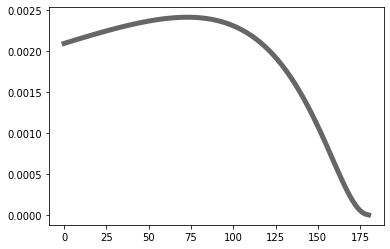

In [88]:
# johnsonsu
# loggammacombined data low
# low 5.74, 0.877, 180.82, 0.019
# (6.064444072172332,
#  1.0514702513247631,
#  183.13906303642042,
#  0.17941739969742476)

x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
# (c = 0.17, loc = 177.11, scale = 2.22)
johnsonsu.pdf(x,6.064444072172332, 1.0514702513247631, 183.13906303642042, 0.17941739969742476)
ax.plot(x, johnsonsu.pdf(x,6.06, 1.05, 183, 1.7), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

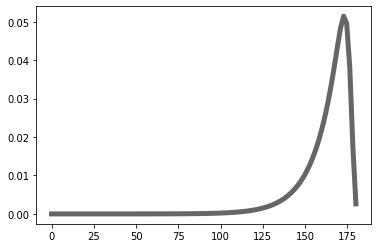

In [56]:
# loggammacombined data low
# low 5.74, 0.877, 180.82, 0.019

x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
# (c = 0.17, loc = 177.11, scale = 2.22)
loggamma.pdf(x,c = 0.17, loc = 177.11, scale = 2.22)
ax.plot(x, loggamma.pdf(x,  c = 0.17, loc = 177.11, scale = 2.22), 'k-', lw=5, alpha=0.6, label='loggamma pdf')

In [ ]:
x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
# (c = 0.17, loc = 177.11, scale = 2.22)
loggamma.pdf(x, 0.17, loc=177.11, scale=2.22)
ax.plot(x, loggamma.pdf(x, 0.17, loc=177.11, scale=2.22),'k-', lw=5, alpha=0.6, label='loggamma pdf')

In [ ]:
x = np.linspace(0,180,100)
fig, ax = plt.subplots(1, 1)
# (c = 0.17, loc = 177.11, scale = 2.22)
loggamma.pdf(x, 0.17, loc=177.11, scale=2.22)
ax.plot(x, loggamma.pdf(x, 0.17, loc=177.11, scale=2.22),'k-', lw=5, alpha=0.6, label='loggamma pdf')

In [9]:
# Separate parts of parameters
x = (x + np.roll(x, -1))[:-1] / 2.0
# Calculate fitted PDF and error with fit in distribution
pdf = distribution.pdf(x, loc=177.11, scale=2.22, arg = 0.17)

NameError: name 'x' is not defined

# in radians

## create radian distribution

In [321]:
# try if this works
high_mu = 0.3*pi # mean 
low_mu = 0.7*pi # mean 
sigma = 0.15*pi # standard deviation

low_dist = np.random.normal(low_mu, sigma, 1000)
high_dist = np.random.normal(high_mu, sigma, 1000)


In [322]:
low_dist

array([1.79062681, 2.18980602, 1.95443701, 2.8034249 , 2.15195977,
       1.82139352, 3.32713102, 2.34783164, 1.99194981, 1.90038474,
       2.16110286, 2.59749562, 2.2573868 , 2.1630837 , 1.90786766,
       1.77803731, 3.32676428, 1.99944441, 2.99819947, 2.14196465,
       1.72433768, 2.69859331, 1.87701216, 2.68296707, 2.23667972,
       1.98662622, 2.18727666, 2.27564134, 1.85123795, 2.30316235,
       2.39038121, 2.68500211, 3.49574631, 1.90011571, 3.17448075,
       2.02819937, 2.00890658, 2.52638383, 1.67376379, 2.02964439,
       2.21047331, 2.22311074, 3.30019134, 2.61661118, 1.37018809,
       2.26919431, 2.8750981 , 1.96407917, 2.48177829, 2.02614402,
       2.62392461, 2.22805204, 1.74446217, 1.94968438, 2.41359084,
       2.56184247, 2.1255317 , 1.93941291, 2.15264028, 2.32916281,
       2.61896733, 2.25321587, 2.12061822, 3.24352851, 2.04670985,
       1.94813181, 2.36285013, 2.76719154, 1.28774502, 2.17343957,
       1.99319761, 1.67218352, 2.6432931 , 1.80254895, 2.69593

## higher rating distribution

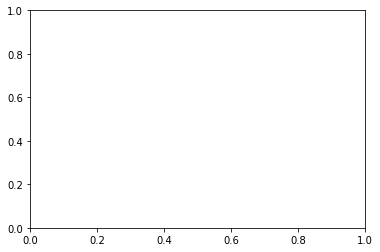

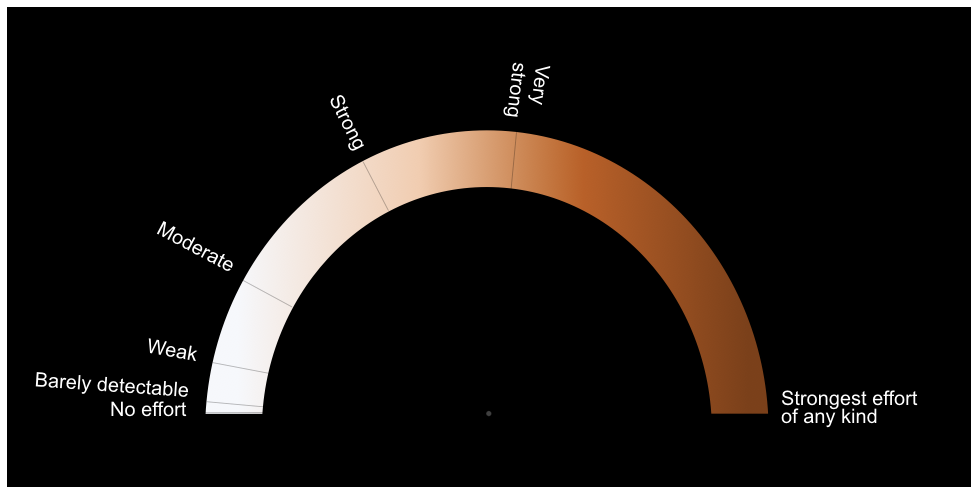

621.0583337939288 198.18278896151736
655.7188271894615 225.50011789023702
726.8346156967846 345.3707599605233
621.2803066299214 198.32831989483034
546.7177073065626 165.1884871963688
699.1046308711425 279.37442954398534
615.815377338257 194.8410040589086
654.3313687481693 224.20399873677232
513.0681234497667 158.8002638846124
606.6714392756861 189.43366581490622


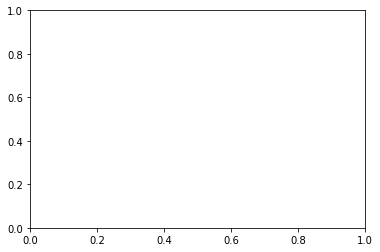

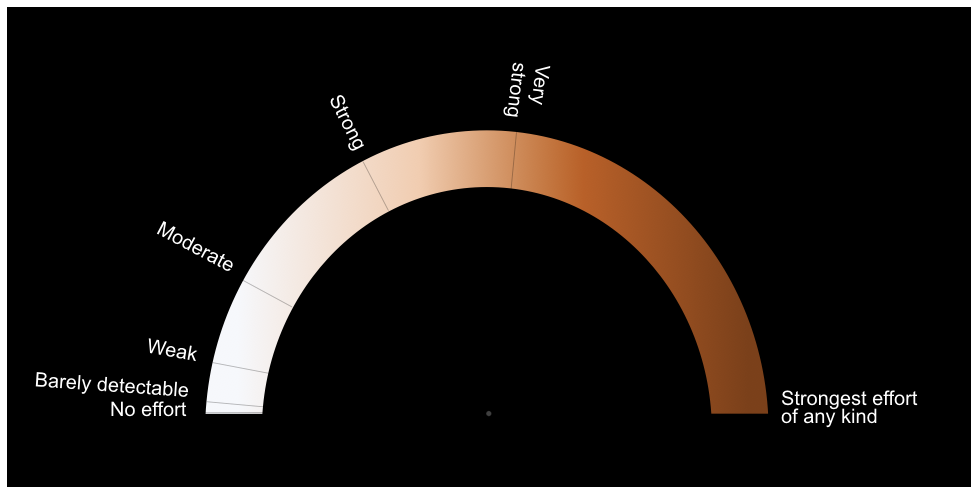

399.7917228350228 171.13368752335623
584.2373946104838 178.22957309810863
651.6159172212454 221.72300605883777
734.3524827074477 390.9464840875198
601.6248022512104 186.66656506305398
485.77547862620804 157.01528475243688
408.7591032077614 168.18411754312345
373.0613776753984 182.24572921029997
639.3476289585903 211.36544098000735
734.3524827074477 390.9464840875198


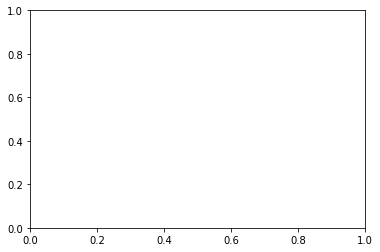

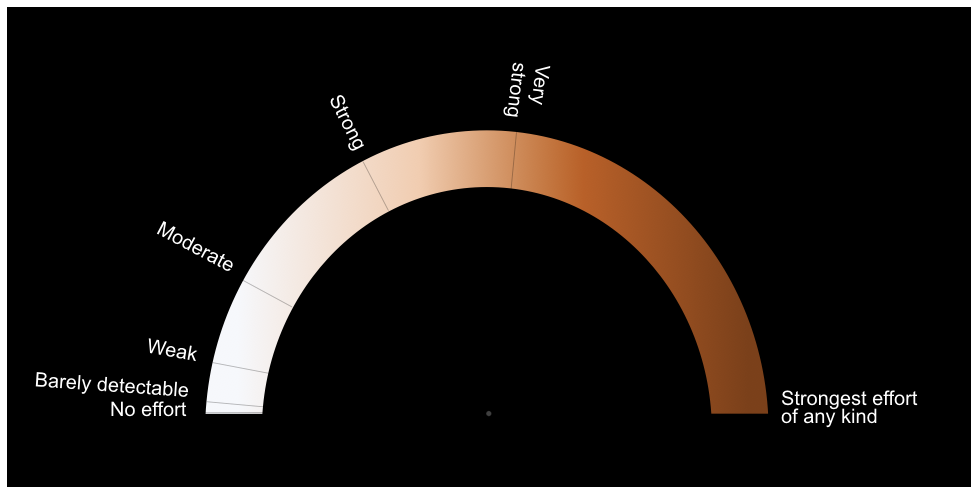

624.2619350021405 200.31587094498292
381.1071034687686 178.51824879944232
627.6216288896408 202.62998168990964
730.7991179331873 363.17863869837186
611.8722301292721 192.44527642762455
644.8107971893181 215.81287332496154
536.8071762828284 162.81147918623697
645.1677042187887 216.11237543997933
472.53402151444675 157.2174285333873
566.1375558385582 171.1089602166769


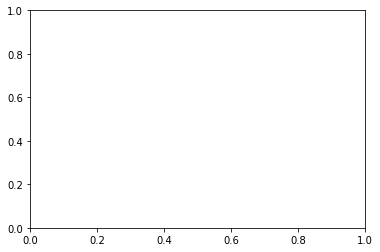

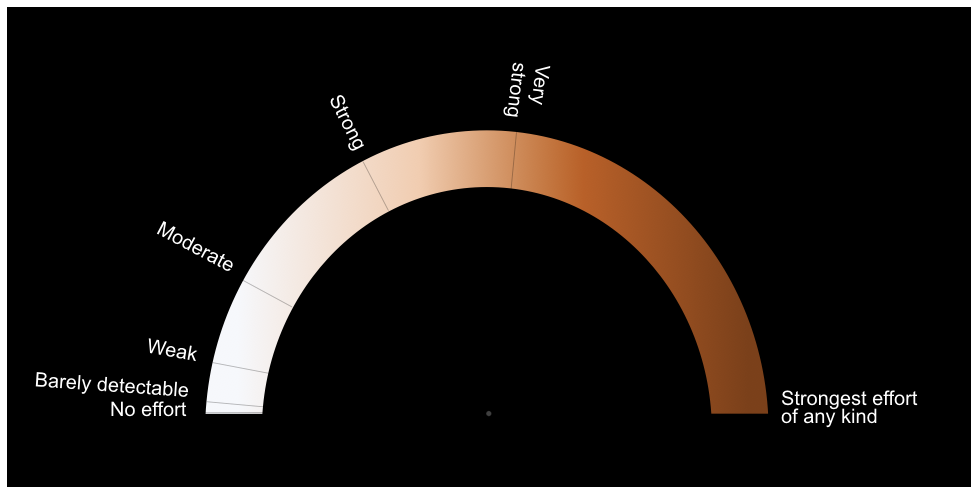

672.5071613146218 242.89450397270448
585.1298893670793 178.62316588279074
655.9178110069116 225.68761461216542
659.5466844664717 229.1799004452058
726.3758072337729 343.6378056265747
538.867231702858 163.27077418048302
659.1062443561218 228.7485348220938
531.3323093816999 161.67837160929164
669.680056791058 239.72343222853505
577.1543543740872 175.2502244869553


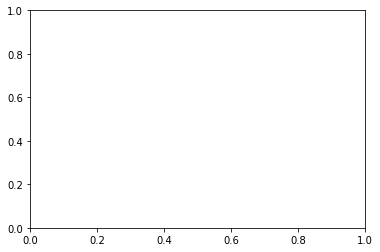

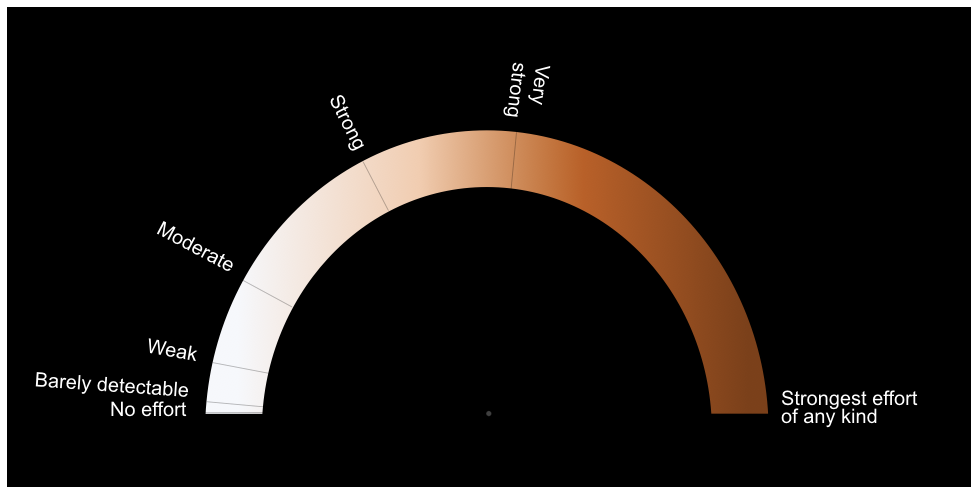

622.5734213678843 199.18279372829548
725.460092597076 340.31882719538555
367.758222648788 184.89437143852527
673.7462962093946 244.31894315860765
631.7939090406368 205.6176688293531
697.8233613615731 277.26191358109463
493.9837751396281 157.2394854555582
620.2837363698602 197.677555076772
591.5819854763001 181.5929806931533
677.9269929871039 249.28942613275237


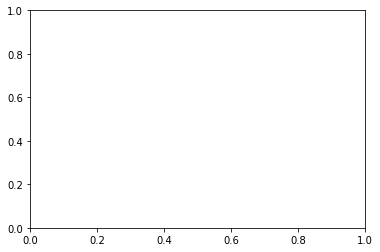

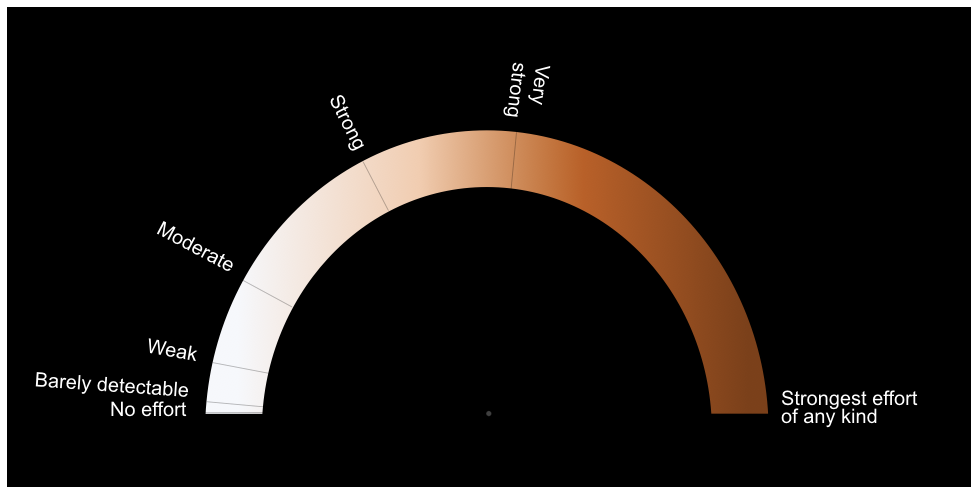

724.6883455908219 337.6505528712977
708.3104888744324 296.13200806621796
710.8884013980428 301.4319912416124
718.6011691818254 319.5791462791991
666.1444282621069 235.90430855579913
549.1211023284595 165.82927843412278
535.1599551801182 162.45722668143756
616.8800827832745 195.5049803064634
634.5279642854737 207.64639054762333
697.922028694894 277.4229443190374


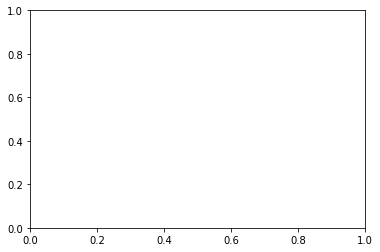

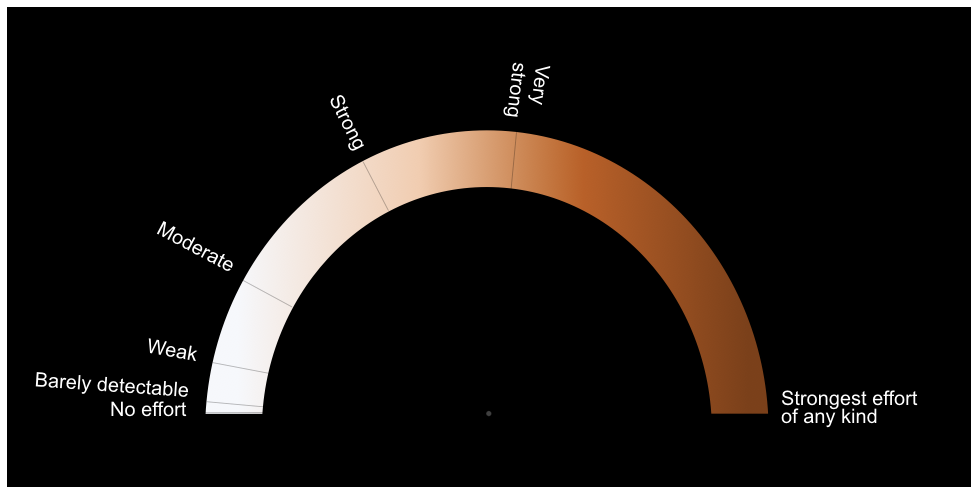

684.1270355002996 257.1714269616511
508.2289781831121 158.26607995758522
698.1591596848373 277.81106752582104
519.6220565186528 159.67526200486122
541.3690460044613 163.85299416772583
489.1769742581481 157.07571576163173
713.8886059450138 308.0324228043073
549.2852695249871 165.87397703248672
532.7918335434173 161.96807228136558
579.5482964692975 176.2288109561739


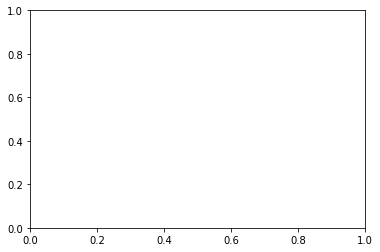

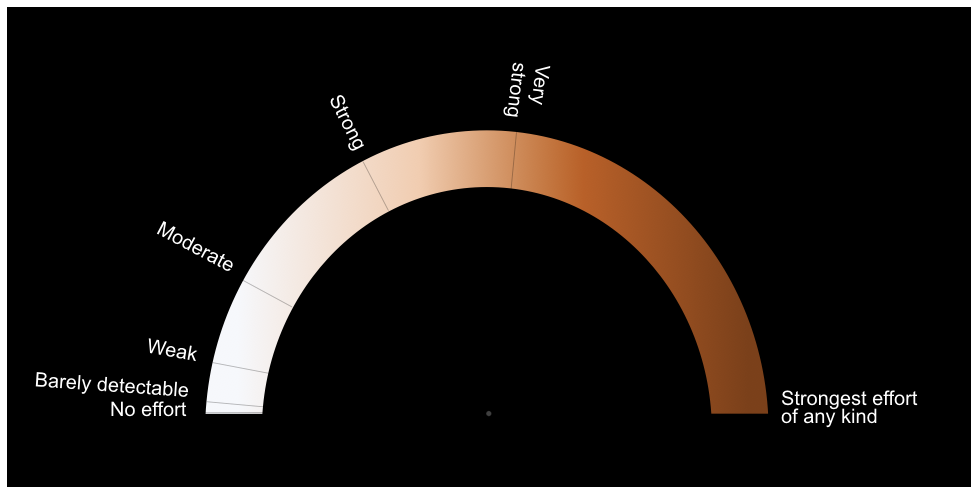

343.0222661798549 199.45231083455823
399.7917228350228 171.13368752335623
646.7405576985591 217.44575242358934
521.8376048483063 160.01076238189168
557.8530677554974 168.37369585269582
610.9208724989736 191.88194368247179
343.0222661798549 199.45231083455823
414.7840835532216 166.40859713640685
531.3323093816999 161.67837160929164
666.6390900924339 236.4291896350286


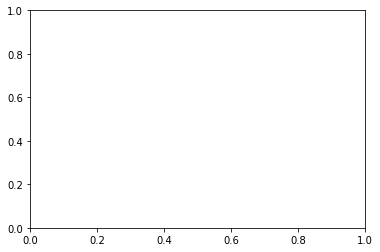

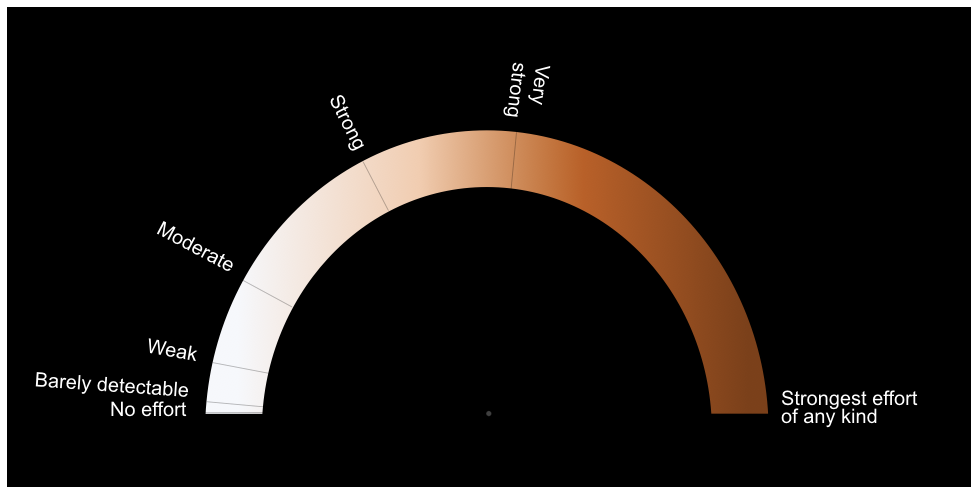

696.4060339599996 274.9781186915229
674.1947567317567 244.83981908427253
705.1306694450207 289.9959425401513
367.758222648788 184.89437143852527
673.5594424367739 244.10276261202594
610.5302200633245 191.6522533574364
724.2006270331434 336.01878653503735
693.2075579466159 270.01517139586736
727.98726345045 349.9640724045107
628.663138211283 203.363791694068


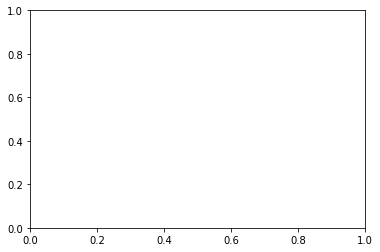

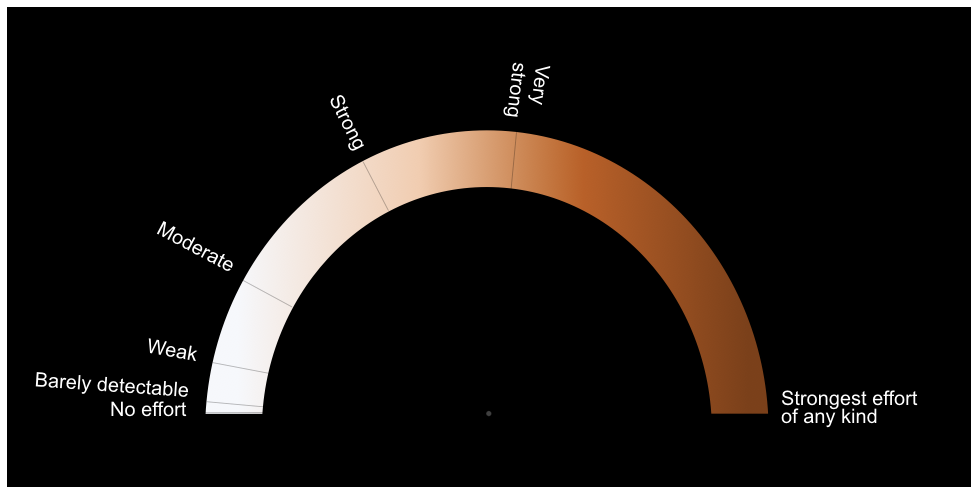

471.6616630015573 157.25520439518567
477.9033331157934 157.05154498058255
326.8539903995287 211.20610806738867
660.8363567964511 230.45524314232762
734.9190093031191 402.61151412813496
644.5903078075225 215.62840843942433
616.3995612060905 195.20440352986105
585.7313661118874 178.89075112724095
665.71243251711 235.4483736645475
696.3087923323285 274.8234032562923


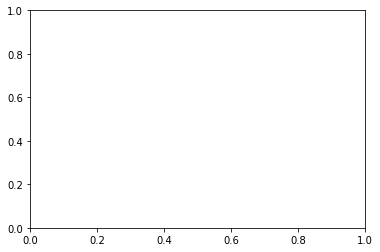

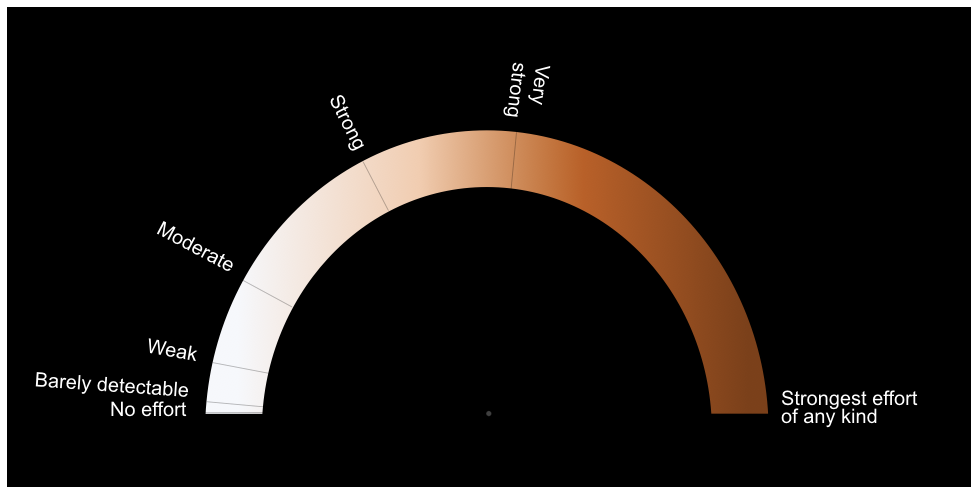

596.2538736743452 183.88323008324
734.5159193009804 393.38775038046356
425.52082663877684 163.64282233912445
730.8037477863037 363.20368373916966
624.3483591349795 200.37439905455315
526.6631160027412 160.81149845141664
654.4309122721763 224.2963391875261
628.5327761920812 203.27151132177733
531.5267818202051 161.71645536717529
679.0079110052654 250.61787088389062


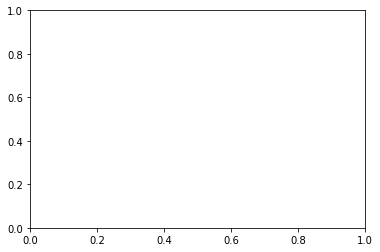

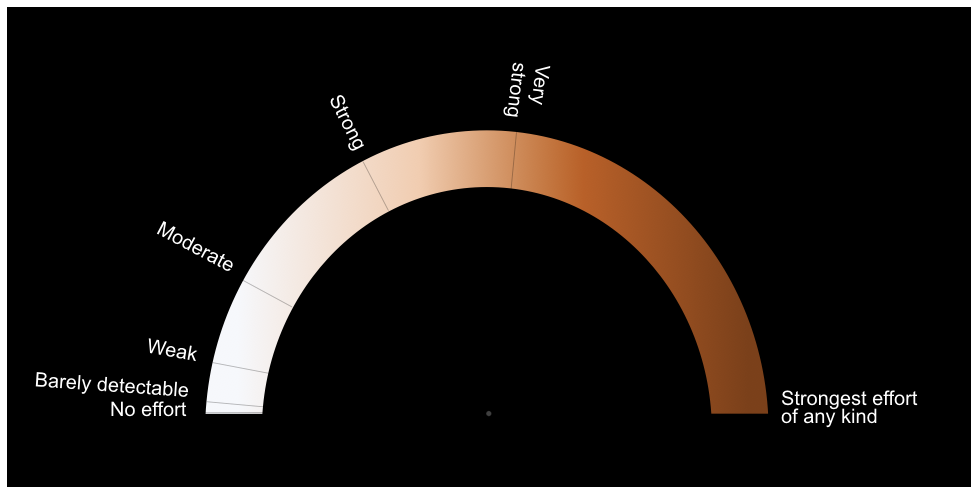

734.9983742071845 408.09479453394613
724.2006270331434 336.01878653503735
686.1881010113042 259.9409660321789
518.9490187641148 159.57733052126696
630.452371499268 204.6429640574079
623.5910588325744 199.86331221821547
381.1071034687686 178.51824879944232
674.4106723043626 245.09162764522398
683.1031754511897 255.82454774230177
535.1599551801182 162.45722668143756


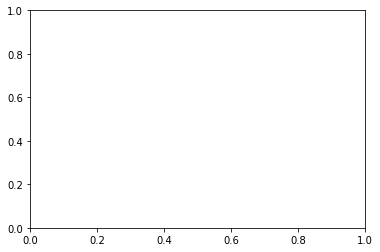

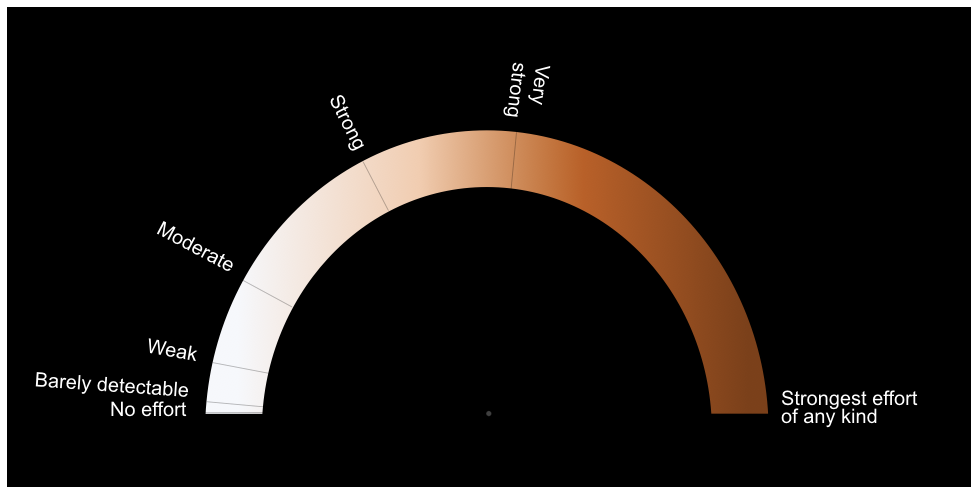

523.4941757405101 160.27480680257443
696.4208131722661 275.00165484272316
399.7917228350228 171.13368752335623
732.8298079864744 375.9989842362193
460.7676541898001 157.98262450623923
701.2651358590695 283.04631617764426
575.4361883872925 174.56546526497218
717.4547046341681 316.6149824110806
707.4307858309159 294.3927473005414
642.6016070746215 213.9837775486405


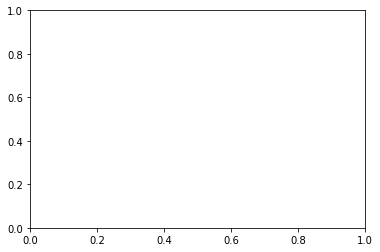

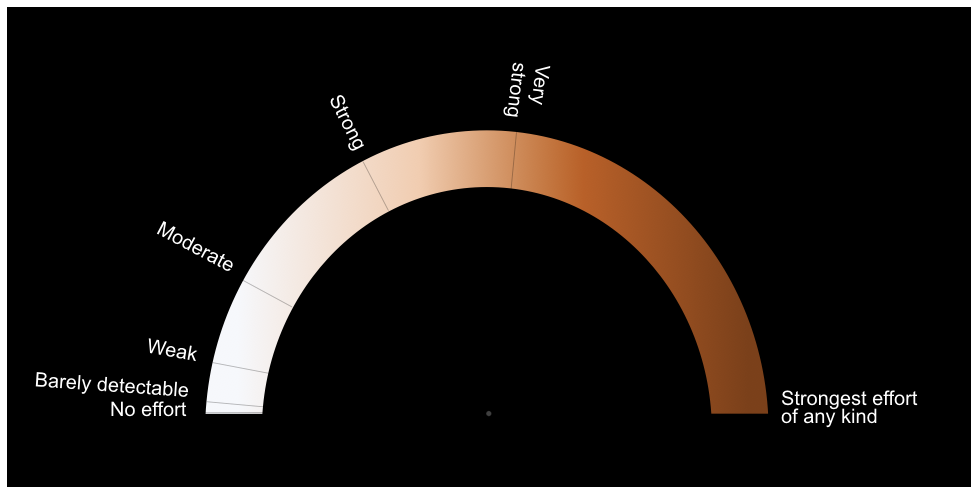

672.025209528489 242.34625667957272
493.9837751396281 157.2394854555582
640.5294824943643 212.3061715633717
653.0793083382847 223.05100464059865
614.9754860288688 194.32240198976547
676.3634412172537 247.39993935452358
566.1375558385582 171.1089602166769
603.5239965738947 187.69033855284172
703.3191752839707 286.67477364749755
555.5487943931877 167.6689567583669


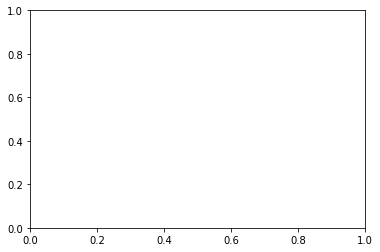

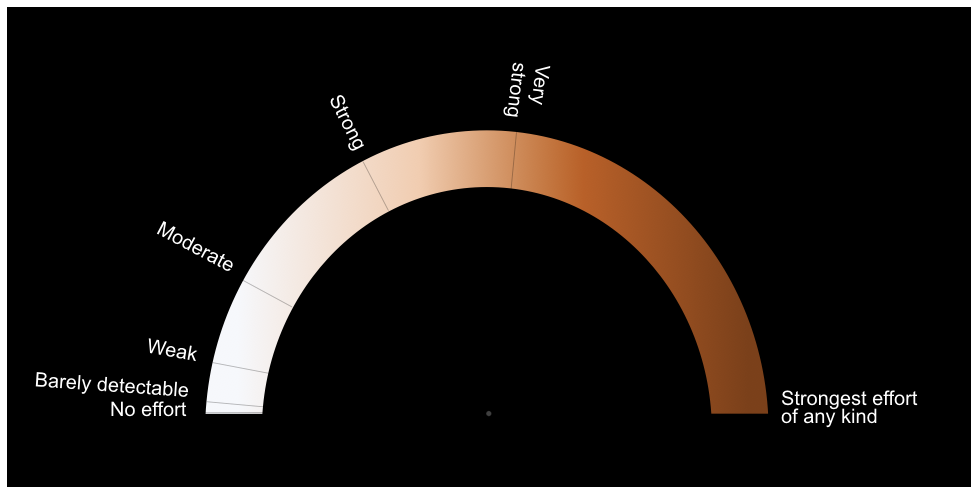

642.7758392189686 214.12649948781055
581.1511109950402 176.90010898227612
529.7619099352602 161.3766493660046
727.9248578735913 349.70570014241616
684.3445669939952 257.46002064801314
575.9219535145269 174.75758164874554
622.0798226731621 198.8552809961626
698.1591596848373 277.81106752582104
537.8555611608784 163.04295616973047
581.1511109950402 176.90010898227612


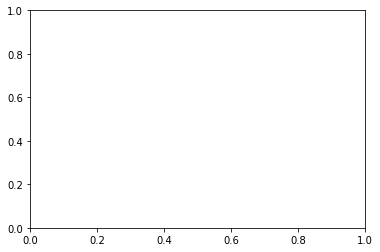

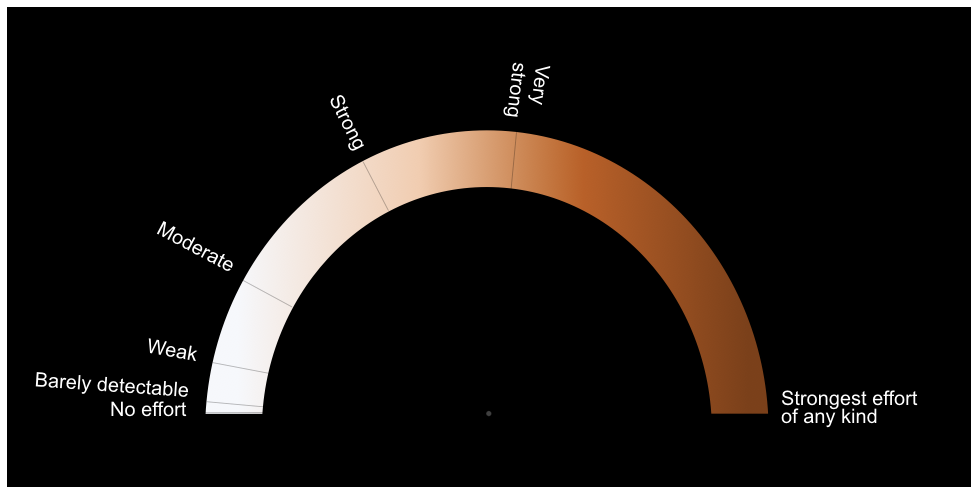

734.9576788753739 404.3817691987117
587.2462532870228 179.5730646248835
668.5730341620174 238.51056046809614
565.8692525194581 171.01536396887656
528.525040311411 161.14627155387714
620.2837363698602 197.677555076772
677.8323234724265 249.1739516526303
507.32395348044844 158.17666518626905
671.993114814395 242.3098606613069
653.0088086211562 222.98654620911128


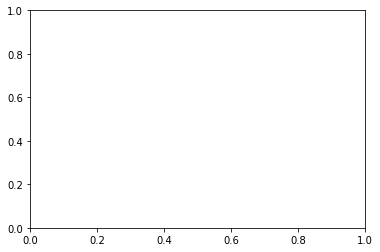

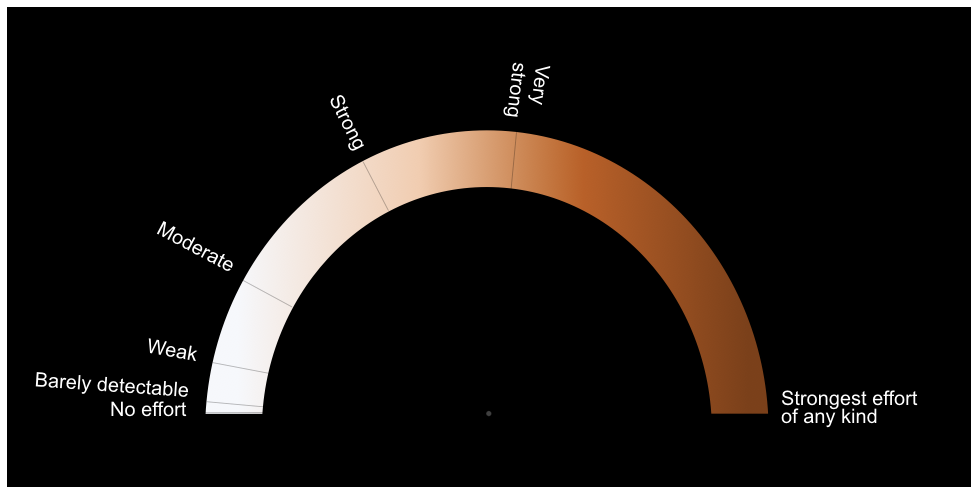

641.1055800330689 212.76894852647084
578.8899271149425 175.9568240048831
652.7770775294373 222.77501793378147
681.2854328335761 253.47866022310188
600.3392234887228 185.98541161828996
679.3224765053343 251.0079583687442
657.7331456464975 227.41715991735373
462.615902322842 157.82578045928344
686.1881010113042 259.9409660321789
617.4280413522473 195.84957964339245


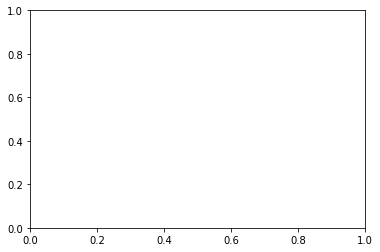

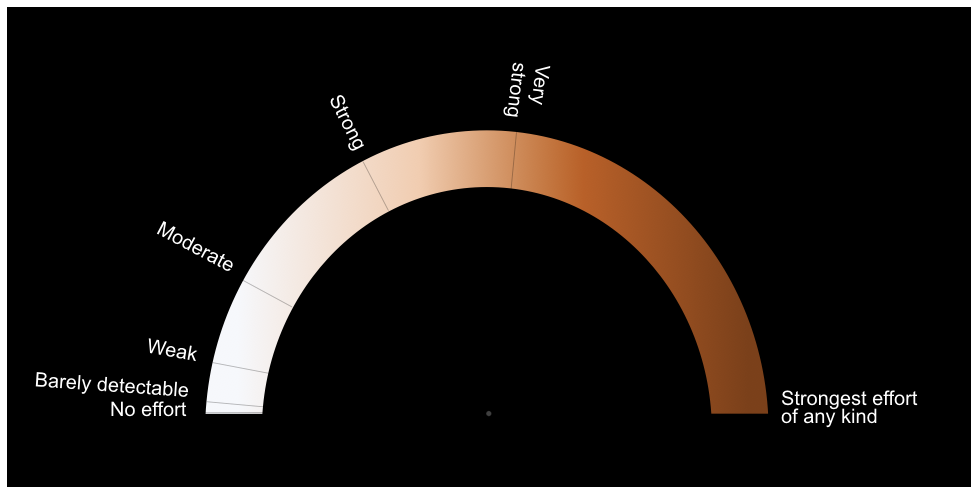

489.31285872551894 157.07908420555543
664.8260210702763 234.51992073089983
600.0355691332842 185.8259075124349
531.7936996663724 161.76898480799812
733.9364936552265 385.87261035005326
535.9864294727331 162.63352847489358
583.294755475114 177.8183354498305
618.6567075611688 196.629433080609
713.6648182949618 307.52221129255815
541.7543572349887 163.94505614882337


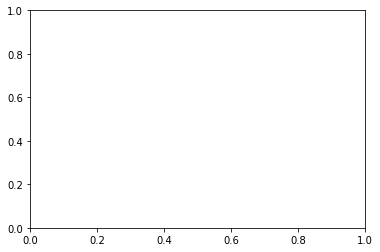

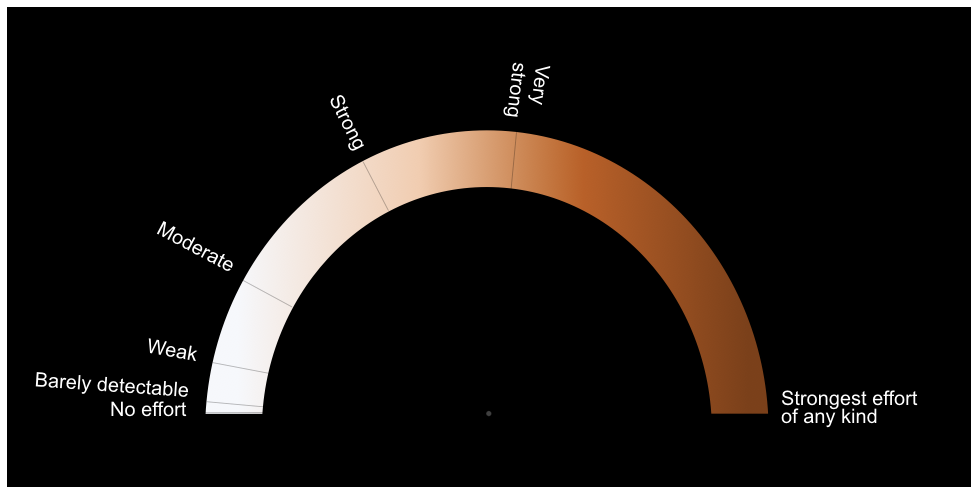

633.8093849332221 207.1076291286289
641.942381395267 213.44612149997778
480.066362478005 157.0170764299899
661.0168511197542 230.63520325633962
668.2950745352475 238.2085032767232
472.53402151444675 157.2174285333873
598.7498424380785 185.15636266456
456.6536108601301 158.3810306874387
515.4419080320339 159.09697360127657
682.3631179918397 254.86257046203275


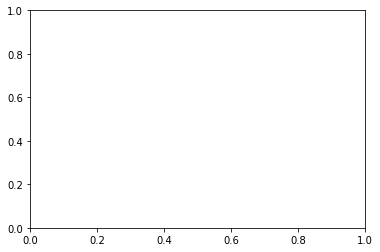

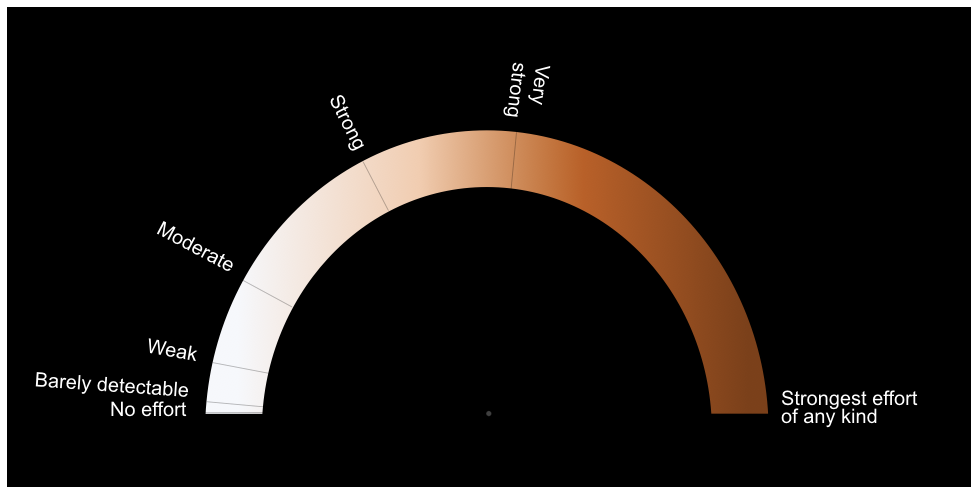

643.6619314435484 214.8563836104092
537.8555611608784 163.04295616973047
446.65221593239613 159.63512959244872
708.3104888744324 296.13200806621796
707.2447746648324 294.02921660039664
614.9754860288688 194.32240198976547
355.0464732347869 191.90118611944493
496.9525931888581 157.38655611572295
648.0733561095396 218.59310122074592
734.9983742071845 408.09479453394613


KeyboardInterrupt: 

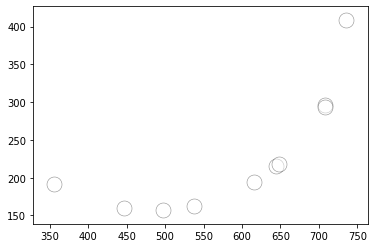

In [324]:
condition_list = ['cognitive', 'pain', 'vicarious']
for ind, condition in enumerate(condition_list):
    high_dir = os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'sch'])

    if os.path.exists(high_dir): # if high_dir exists, wipe out every stimuli
        shutil.rmtree(high_dir) # we don't want multiple high cues than intended

    if not os.path.exists(high_dir):
        os.makedirs(high_dir)

    x0, y0 = 0.5, 0.5
    r = 252
    centerX = 483
    centerY = 409

    sample_data = pd.DataFrame()
    for fignum in range(1,57):

        # Read Images 
        plt.cla()
        img_scale = os.sep.join([main_dir, 'stimuli', 'ratingscale', 'task-'+ condition + '_scale.png'])
        display_image_in_actual_size(img_scale)

        # sample 10 radians
        high_sample = []
        high_sample = abs(np.random.choice(high_dist, 10, replace=True))
        # add sample to pd dataframe
        col_name = []
        col_name = 'figure' + '{:03d}'.format(fignum)
        sample_data[col_name] = high_sample

        for rad in range(10):
            if high_sample[rad]/pi > 1:
                # if the radians goes off the circular rating chart, 
                # flip the radians so that it's within the range of the circular rating image
                high_sample[rad] = (1 - (high_sample[rad]/pi-1))*pi
                x = centerX + r * cos(high_sample[rad])
                y = centerY - r * sin(high_sample[rad])
            else:
                x = centerX + r * cos(high_sample[rad])
                y = centerY - r * sin(high_sample[rad])
            print(x,y)
            plt.scatter( x,y,s=15**2, c='white', alpha=0.5, edgecolors='black', linewidths=.5)

        # calculate sample mean
        file_mean_original = np.mean(high_sample)
        file_mean_round = '{:.2f}'.format(round(file_mean_original, 2))
        file_mean = str(file_mean_round).replace(".", "")
        # calculate sample std
        file_std_original = np.std(high_sample)
        file_std_round = '{:.2f}'.format(round(file_std_original, 2))
        file_std = str(file_std_round).replace(".", "")
        # save image
        file_name = 'h' + '{:03d}'.format(fignum) + '_M' + str(file_mean) + '_STD'+ str(file_std) + '.png'
        file_fullname = os.path.join(high_dir, file_name)
        plt.savefig(file_fullname)

    # save pd dataframe
    sample_data.rename(index={0:'s01',1:'s02',2:'s03',3:'s04',4:'s05',5:'s06',6:'s07',7:'s08',8:'s09',9:'s10'}, inplace=True) 
    sample_data.loc['sample_mean'] = sample_data.mean()
    sample_data.loc['sample_std'] = sample_data.std()
    sample_data.to_csv(os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'sch_data.csv']))

## low ratings

<IPython.core.display.Javascript object>


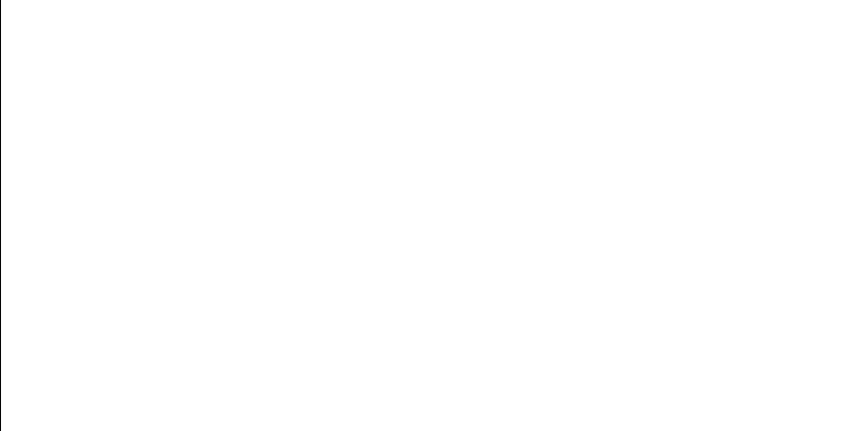

611.651150623 192.313864211
676.890570685 248.032777872
733.681177945 383.252242352
620.39544523 197.75016774
734.704505123 396.799913905
719.053456389 320.780015152
697.274345395 276.370799198
685.048799614 258.400257057
660.994906333 230.613303972
606.426791351 189.296046515


<IPython.core.display.Javascript object>


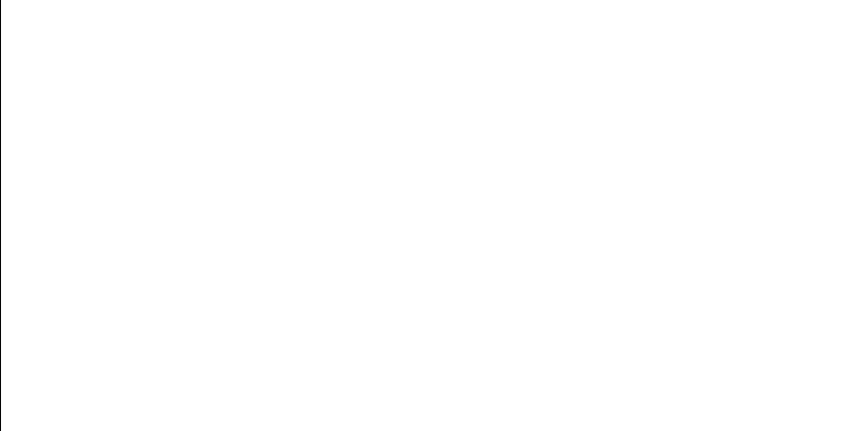

700.745479566 282.150064531
693.363345 270.251078994
645.982930463 216.800717021
715.786122766 312.487715562
655.167336031 224.982586683
563.024324113 170.043712051
387.977441929 175.601813508
715.628418104 312.108209377
594.281406721 182.901683955
543.84964908 164.456915439


<IPython.core.display.Javascript object>


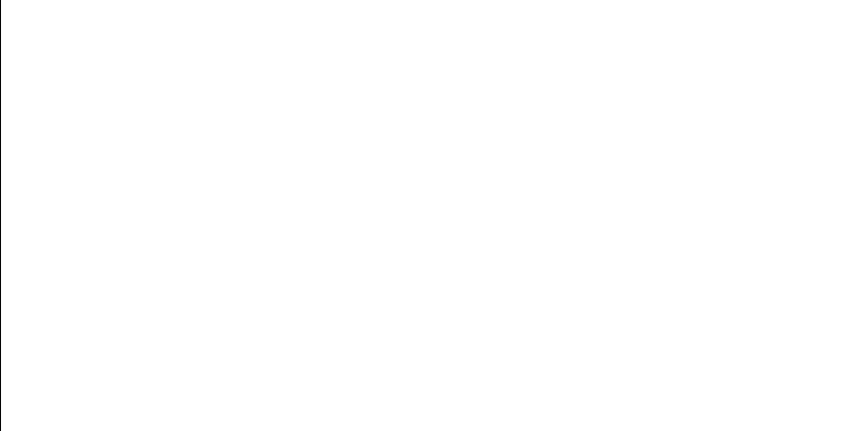

711.980405272 303.776552036
572.754166002 173.525607156
726.633972309 344.606774139
683.2895766 256.068363295
545.19276935 164.795046241
720.427871688 324.548796658
599.978689127 185.796088094
734.850109024 400.309626907
518.093157428 159.45547431
641.212008774 212.854746987


<IPython.core.display.Javascript object>


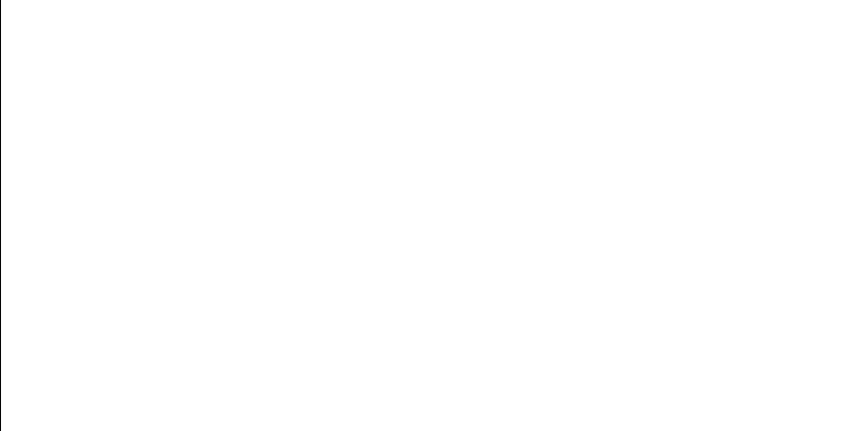

699.297759274 279.696947703
557.092737781 168.138491643
712.023740893 303.870907417
678.220948118 249.648873816
503.482569956 157.833791429
571.410767413 173.01793245
734.851639403 400.354091708
724.941873857 338.515039375
661.108746193 230.726966342
606.426791351 189.296046515


<IPython.core.display.Javascript object>


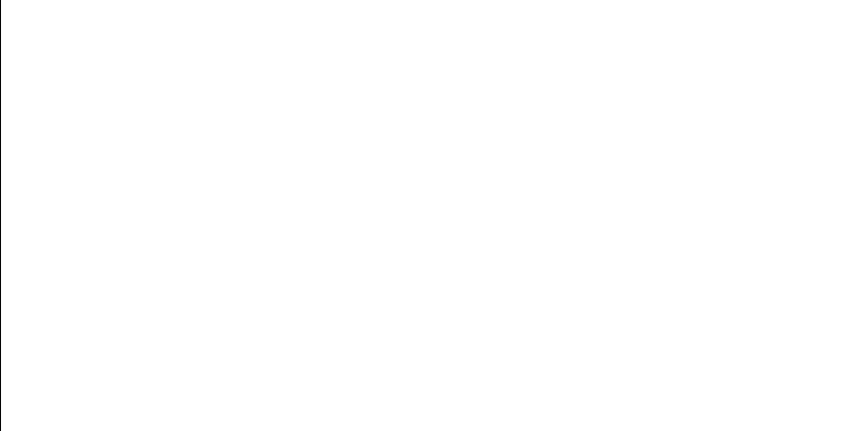

461.4683604 157.92154912
636.448237874 209.105932321
570.143148603 172.546893335
665.506545919 235.231876638
637.523915348 209.936292646
586.076415208 179.045107406
640.049027487 211.922342805
734.969739078 405.094799761
657.441992662 227.137438718
515.648181365 159.123838165


<IPython.core.display.Javascript object>


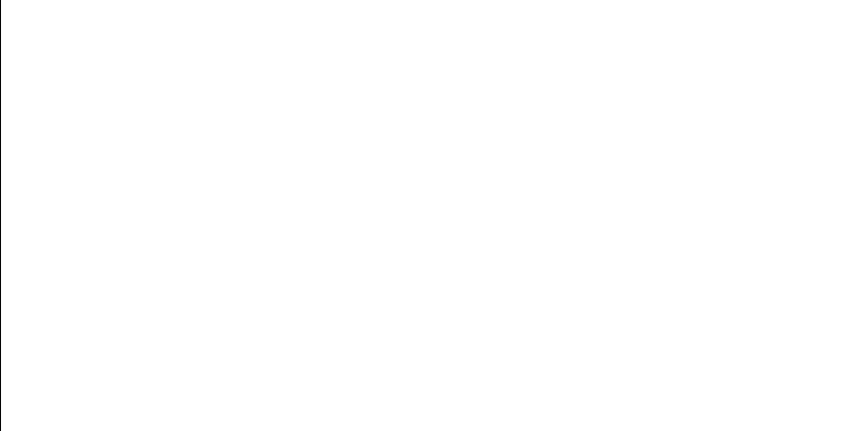

626.67799411 201.971900438
537.520517843 162.96847126
611.864390438 192.440611201
525.254813675 160.567854895
492.263170587 157.170308203
675.88347178 246.827356456
626.67799411 201.971900438
388.856555195 175.245830411
693.445282086 270.375387295
717.614232013 317.020860317


<IPython.core.display.Javascript object>


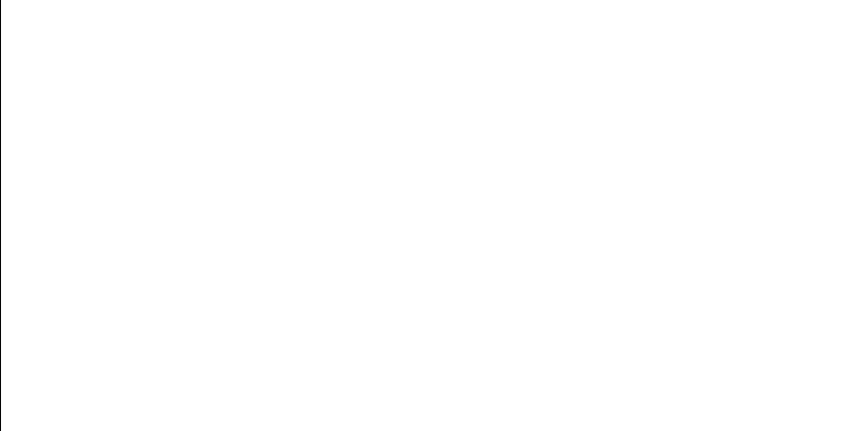

630.301558976 204.534230926
686.483792133 260.344874494
692.388242564 268.783867276
668.935425148 238.905856436
615.745486303 194.797675395
695.937111194 274.234326788
652.096095747 222.156454746
730.11378595 359.616026956
583.753972392 178.018102339
662.129458601 231.752610566


<IPython.core.display.Javascript object>


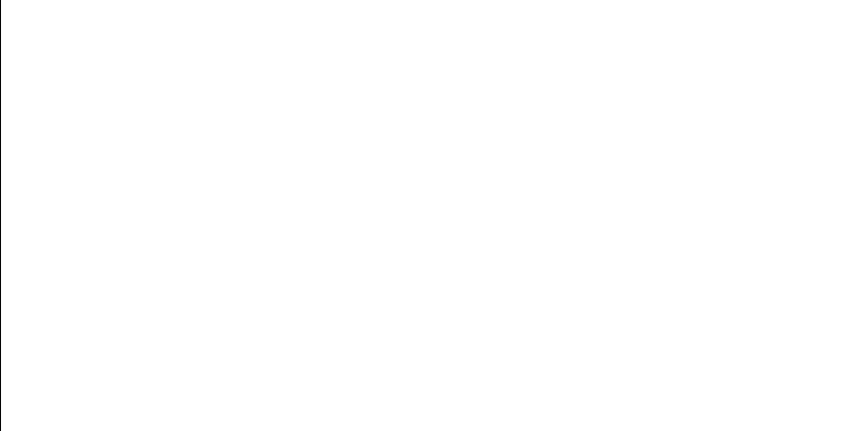

507.24757582 158.169270091
422.235746039 164.435682405
665.79755679 235.538035202
671.767968162 242.054936593
543.84964908 164.456915439
672.620329317 243.023704374
615.162032521 194.437195302
470.062492153 157.332320528
718.487092244 319.279158573
541.692866623 163.930321322


<IPython.core.display.Javascript object>


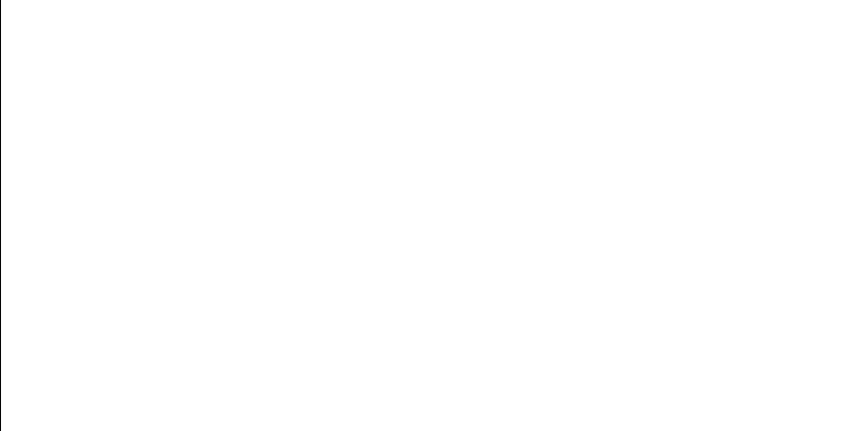

724.989915746 338.680154455
529.371455437 161.303233528
426.123332237 163.502454871
632.790789281 206.350747728
573.049747646 173.638484563
687.606330017 261.893746846
595.462960962 183.487068194
669.571827351 239.604152238
387.977441929 175.601813508
457.200645851 158.324126958


<IPython.core.display.Javascript object>

581.116765406 176.88558781
602.384074203 187.073339081
691.494836512 267.458828788
653.282521922 223.237079244
671.424480509 241.667351826
693.445282086 270.375387295
720.178048531 323.849701732
445.071743729 159.87062121
642.647490097 214.021337307
672.501993058 242.888607774


<IPython.core.display.Javascript object>

712.915575824 305.835917134
669.571827351 239.604152238
570.143148603 172.546893335
734.297553363 390.197349292
567.576676579 171.6167955
566.038132355 171.074237261
734.753168004 397.849107669
597.638293598 184.585068142
417.207705002 165.740110337
686.2516707 260.027659085


<IPython.core.display.Javascript object>

603.316008768 187.577196219
734.953108424 404.138811292
659.932896341 229.559898038
691.514147601 267.487278839
644.459938357 215.519540248
515.64354269 159.123232131
712.965056596 305.946262829
598.008884768 184.774764078
720.427871688 324.548796658
622.47337936 199.11627874


<IPython.core.display.Javascript object>

680.791033619 252.850369774
593.790037888 182.660503878
518.093157428 159.45547431
636.479646499 209.130047004
574.162797965 174.067362278
650.990350315 221.161659396
647.890540545 218.434762774
622.47337936 199.11627874
432.113295229 162.191282007
567.418382531 171.560456767


<IPython.core.display.Javascript object>


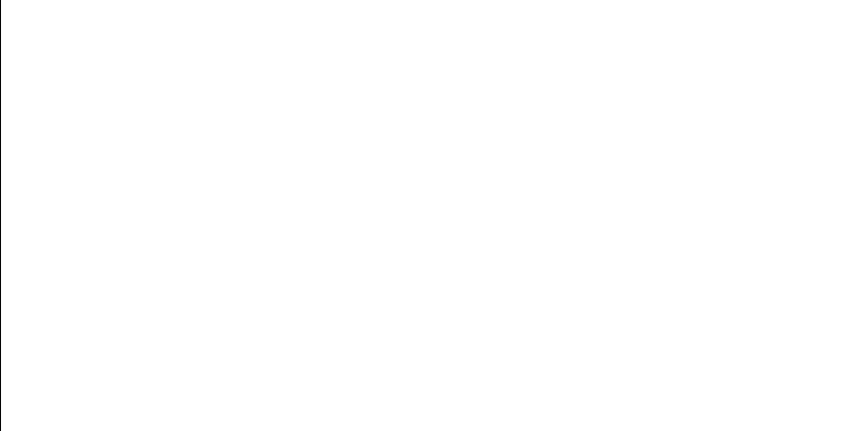

657.265866957 226.9686631
704.722233206 289.236686326
637.848529844 210.188700509
533.921725647 162.198505156
664.14201524 233.809902349
458.76825405 158.167740336
708.154231473 295.820620033
512.458349467 158.727736961
712.187153015 304.22763297
682.875071758 255.527019675


<IPython.core.display.Javascript object>


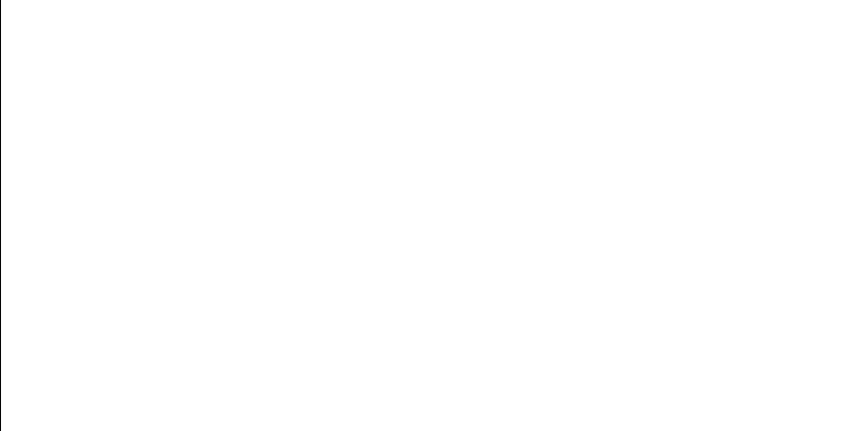

712.086913033 304.008637132
455.249808569 158.532583206
730.231742878 360.209987563
534.095197546 162.234360601
584.506112312 178.347644358
725.391294517 340.076416646
556.807777182 168.051017791
703.155466514 286.380382629
518.093157428 159.45547431
523.211454586 160.228942761


<IPython.core.display.Javascript object>


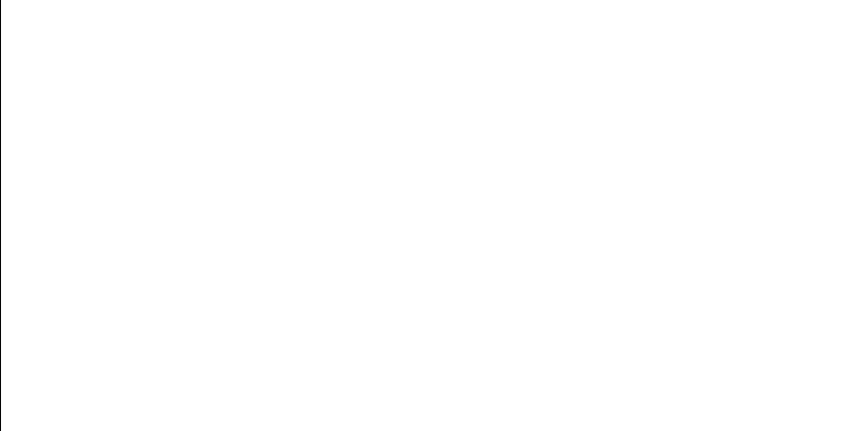

645.982930463 216.800717021
694.107515999 271.385986583
734.297553363 390.197349292
732.874401271 376.338346808
725.259801536 339.615646148
724.858526238 338.229573365
522.427273526 160.103455021
678.220948118 249.648873816
692.884632496 269.527991905
389.936740268 174.813685951


<IPython.core.display.Javascript object>


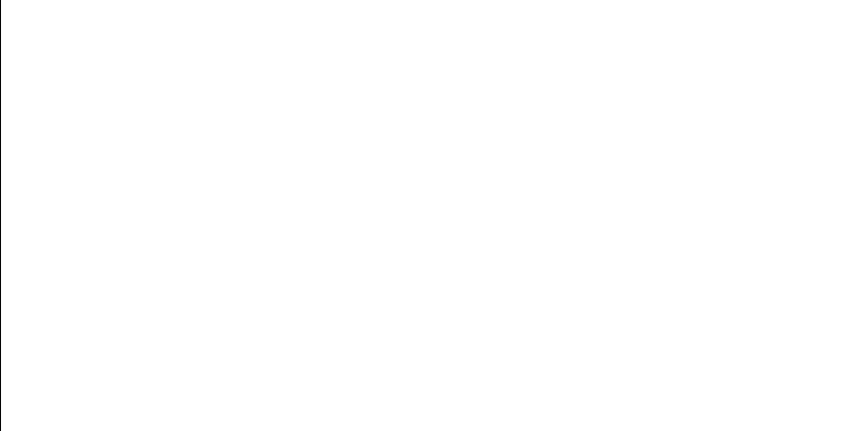

719.471816626 321.907635573
613.610480973 193.489206164
677.988375616 249.364373104
627.511419396 202.552792065
592.911052304 182.232364343
709.488427876 298.514742892
580.288951833 176.537401178
529.371455437 161.303233528
681.035118777 253.160044498
594.110279251 182.8175386


<IPython.core.display.Javascript object>


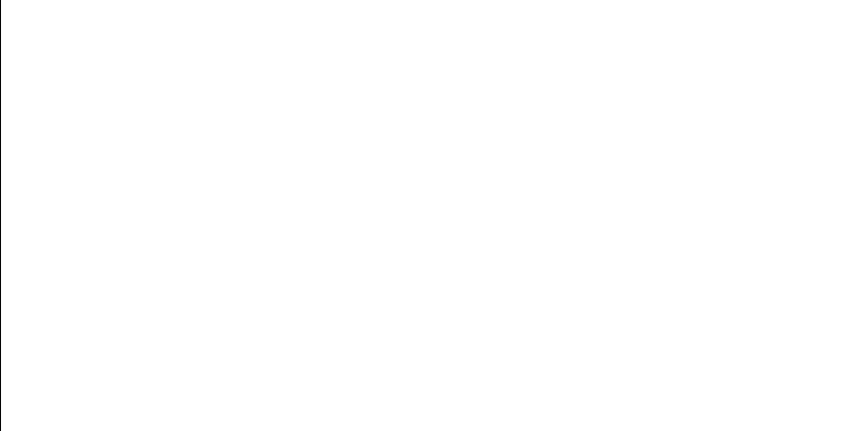

537.686191575 163.005243042
604.137968588 188.025810181
667.071211583 236.89018312
570.233052336 172.580046146
569.281661596 172.23117842
498.614675495 157.484231291
660.147853878 229.772106338
691.514147601 267.487278839
503.90604058 157.868684814
718.390086347 319.024963186


<IPython.core.display.Javascript object>


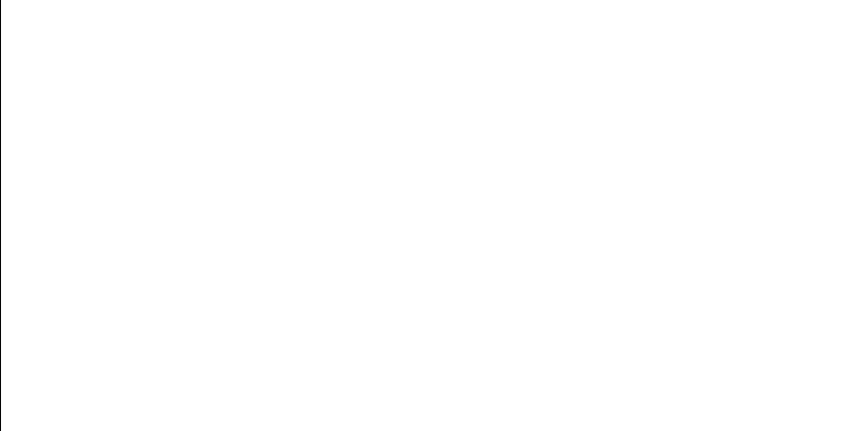

572.754166002 173.525607156
694.107515999 271.385986583
615.150087408 194.429838053
407.614510386 168.539965991
581.431831642 177.019021212
621.744517013 198.633750333
725.935570334 342.020087588
572.222500289 173.32364259
608.978101667 190.748956703
622.741935595 199.294989482


/Users/h/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


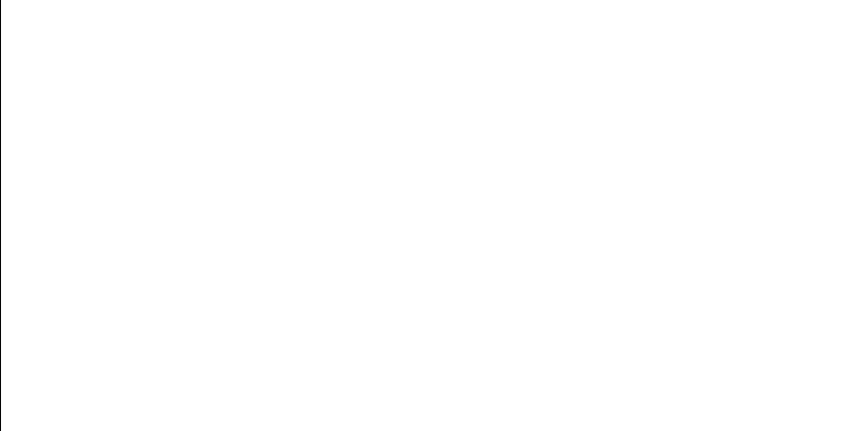

656.351196625 226.097395785
455.175599076 158.540816273
651.369743176 221.501654453
399.449593179 171.25364457
734.200389875 388.940983908
399.449593179 171.25364457
641.212008774 212.854746987
576.223448411 174.877406758
732.40000167 372.894056346
589.220641864 180.480470765


<IPython.core.display.Javascript object>


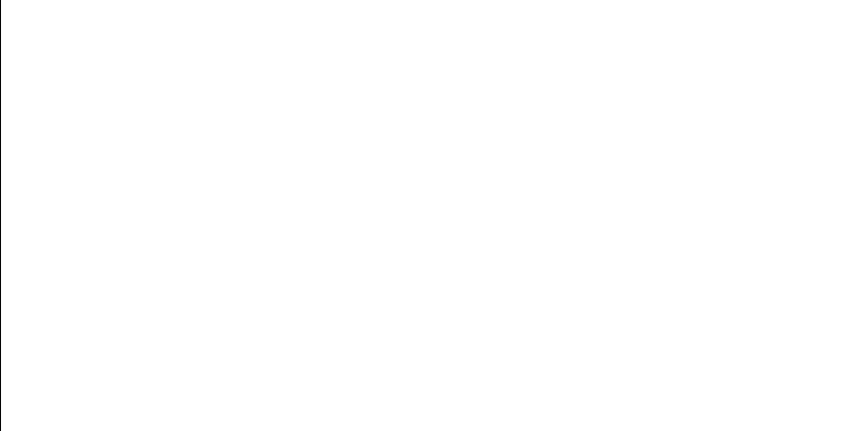

683.758532276 256.684499415
682.770145533 255.390465942
512.458349467 158.727736961
574.870216398 174.343094415
609.992672317 191.337735981
712.965056596 305.946262829
448.460860761 159.378190335
523.106167105 160.21194691
687.003339969 261.058669461
620.160982078 197.59785953


<IPython.core.display.Javascript object>


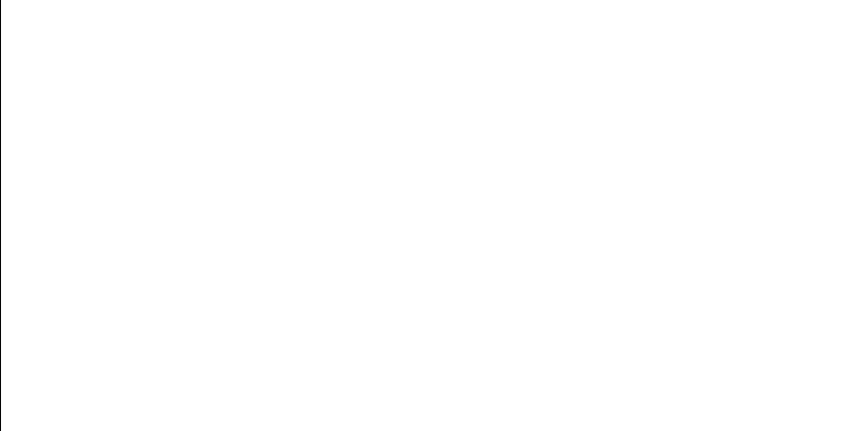

698.39888322 278.205041734
732.270799573 372.012590249
443.078019237 160.18232488
568.388463583 171.90759125
680.303399427 252.234670368
666.277649038 236.045371953
651.300788186 221.439757156
700.667932514 282.017043839
686.86228895 260.864362343
548.830947137 165.750567526


<IPython.core.display.Javascript object>

726.516009318 344.162100545
580.101276805 176.458945468
415.019640229 166.342482735
553.496800566 167.061575788
379.617893588 179.182376494
675.88347178 246.827356456
522.427273526 160.103455021
734.753168004 397.849107669
541.692866623 163.930321322
681.984988414 254.374729149


<IPython.core.display.Javascript object>

734.373629249 391.243352843
680.303399427 252.234670368
608.22783744 190.317607636
734.198534799 388.917766186
565.784483857 170.985863377
734.270245465 389.835873521
605.136693921 188.576253552
727.028130684 346.11700202
722.738644062 331.350901206
717.591971866 316.964100829


<IPython.core.display.Javascript object>

602.384074203 187.073339081
571.173824978 172.929297479
611.130392223 192.005524059
580.101276805 176.458945468
696.07214895 274.447930741
630.301558976 204.534230926
519.375015315 159.639100377
569.798730474 172.420245185
637.207566385 209.691127971
647.890540545 218.434762774


<IPython.core.display.Javascript object>

646.829347598 217.521685652
716.164727111 313.40601467
415.505670824 166.206846206
709.486396073 298.51057791
620.391752288 197.747765921
668.949069763 238.920773008
656.815703225 226.538767645
734.786071441 398.618563275
557.822362973 168.36414648
713.561022666 307.286604484


<IPython.core.display.Javascript object>

688.576598745 263.252746001
692.388242564 268.783867276
668.949069763 238.920773008
724.989915746 338.680154455
640.049027487 211.922342805
533.909479577 162.195978782
583.753972392 178.018102339
608.22783744 190.317607636
591.070096526 181.34927139
669.629955889 239.66819683


<IPython.core.display.Javascript object>

659.549750831 229.182911041
573.296972556 173.733222177
590.291206746 180.981147808
568.388463583 171.90759125
451.504493638 158.975935
522.106560984 160.052863266
669.048777237 239.029848242
689.757650359 264.933091871
613.113358249 193.18870742
734.297553363 390.197349292


<IPython.core.display.Javascript object>

620.399671068 197.752916256
620.391752288 197.747765921
716.170822071 313.420882328
452.902712915 158.803770392
600.419652718 186.027748014
733.143185223 378.464989171
591.070096526 181.34927139
470.062492153 157.332320528
714.198232262 308.743442116
515.64354269 159.123232131


<IPython.core.display.Javascript object>


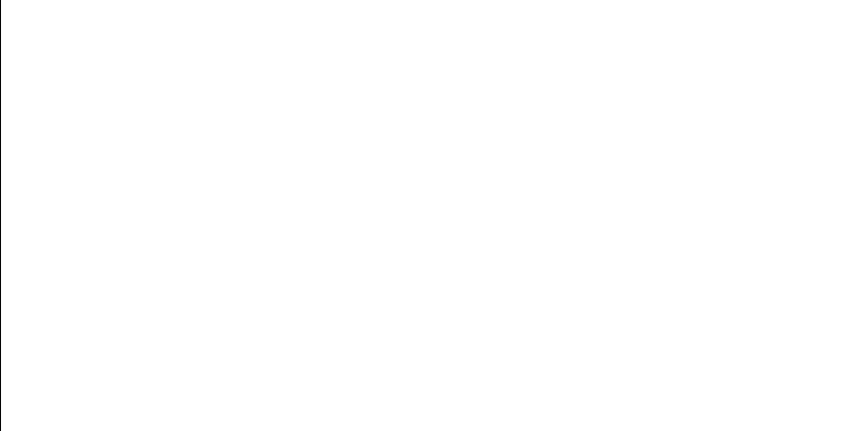

468.4964277 157.417714474
591.070096526 181.34927139
581.431831642 177.019021212
412.52951563 167.053909243
629.492001155 203.953435538
699.861303977 280.644342401
658.069990997 227.741901554
719.807952736 322.825795501
400.664654874 170.830121672
717.360304884 316.375772637


<IPython.core.display.Javascript object>


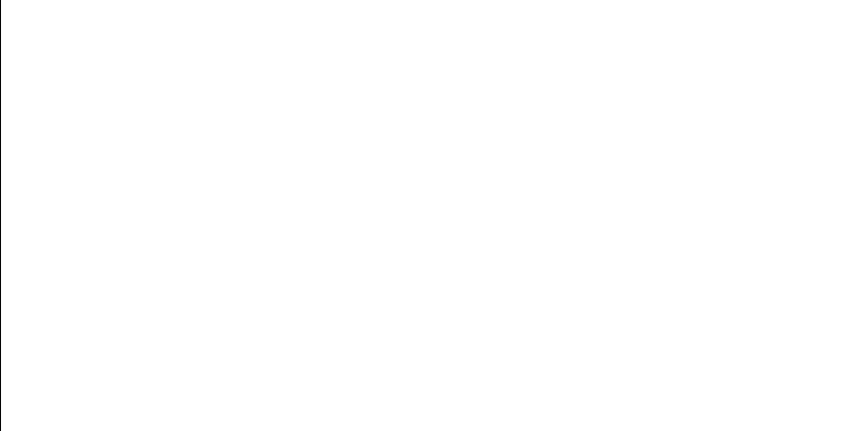

647.811710458 218.366581902
622.741935595 199.294989482
671.320493772 241.550331067
722.196164919 329.695556945
531.720366249 161.754522968
541.744477855 163.94268768
594.48648209 183.002733841
701.133420324 282.818341517
578.146342757 175.652247793
670.459323691 240.586811795


<IPython.core.display.Javascript object>


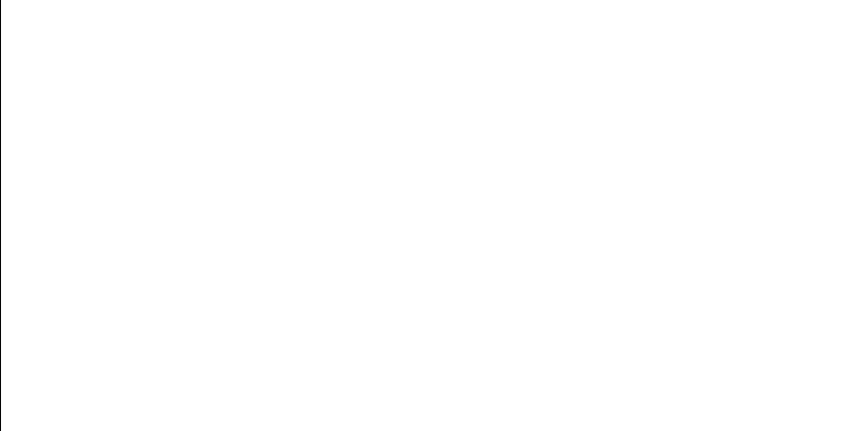

569.587275814 172.342771783
570.367751581 172.629790406
415.019640229 166.342482735
661.847720568 231.468332831
548.278164097 165.601640737
597.638293598 184.585068142
702.150779831 284.593666964
652.591531146 222.606028629
611.88152866 192.450810276
578.343967805 175.73292602


<IPython.core.display.Javascript object>


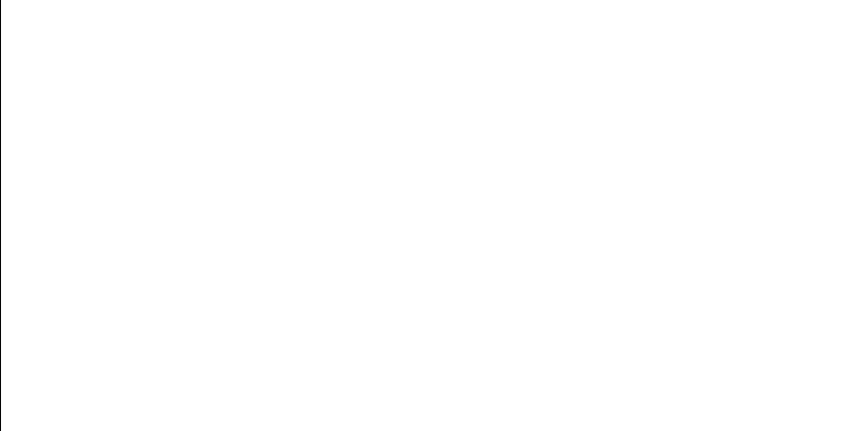

422.065949255 164.477932571
699.297759274 279.696947703
720.792603049 325.581309437
594.110279251 182.8175386
701.519138366 283.487505929
607.28661791 189.781304154
666.718756233 236.514004603
616.148691497 195.048075604
569.806335014 172.423035353
635.042740568 208.034816347


<IPython.core.display.Javascript object>


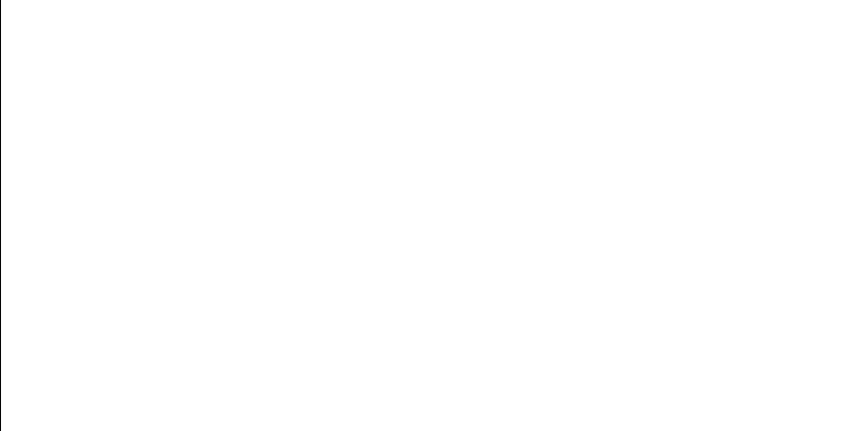

623.779563111 199.990156666
669.571827351 239.604152238
468.819375148 157.399304693
733.346638124 380.180548579
711.091936549 301.864252084
621.565154206 198.515563426
589.703175953 180.705382802
654.622416528 224.474266984
626.079863057 201.558073698
541.933599992 163.988100713


<IPython.core.display.Javascript object>


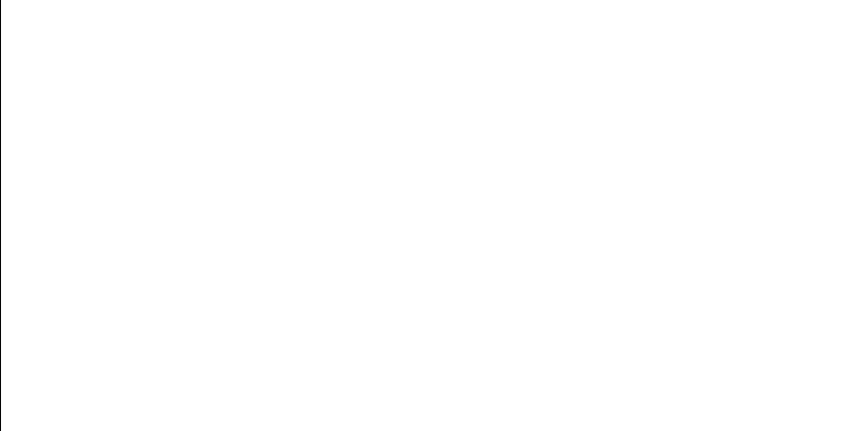

430.805958547 162.464440624
553.153803142 166.961895759
537.686191575 163.005243042
734.969386964 405.07214652
390.014370848 174.782851244
680.405596131 252.363380347
523.89710511 160.340741589
627.486893389 202.535626224
708.154231473 295.820620033
720.28181865 324.139299212


<IPython.core.display.Javascript object>

501.365541992 157.670123409
481.770319645 157.003000244
526.643694651 160.80808249
638.287023233 210.531008933
505.826037103 158.03591486
522.427273526 160.103455021
453.744508908 158.703942818
685.048799614 258.400257057
522.427273526 160.103455021
679.194643154 250.849242817


<IPython.core.display.Javascript object>


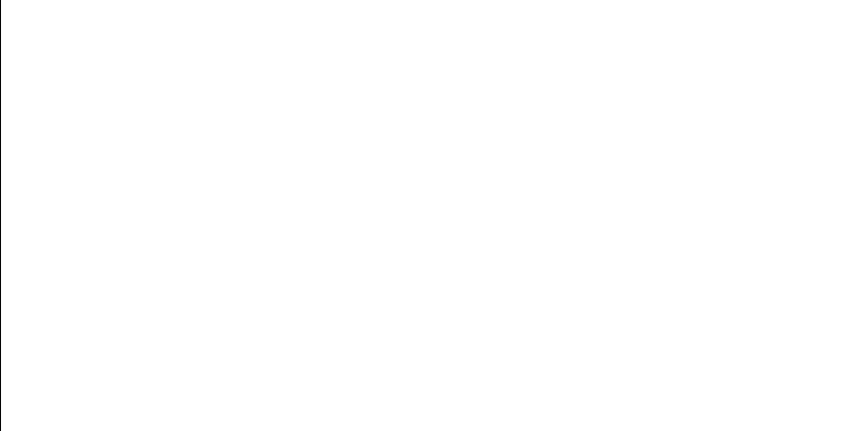

455.090190727 158.550319333
676.457709199 247.512803134
615.745486303 194.797675395
543.84964908 164.456915439
721.179010171 326.691075126
678.583495607 250.094064787
491.922219157 157.157997933
507.24757582 158.169270091
734.060032824 387.254657545
423.875480612 164.034101951


<IPython.core.display.Javascript object>

498.614675495 157.484231291
734.753168004 397.849107669
554.506930557 167.358201293
639.365895233 211.379892703
508.831196479 158.327406188
492.305481319 157.171868098
605.993014054 189.052918879
618.164286185 196.315689953
734.949897724 403.975158024
712.965056596 305.946262829


<IPython.core.display.Javascript object>


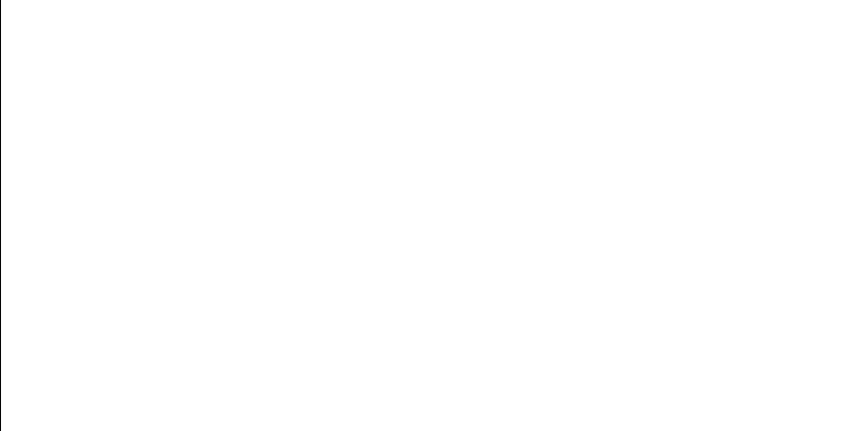

708.626851292 296.765762906
734.373629249 391.243352843
604.87975453 188.434079161
720.792603049 325.581309437
452.902712915 158.803770392
689.993622926 265.27234063
483.837761365 157.001392552
567.522121258 171.597365183
551.990344299 166.627698791
613.445960439 193.389584191


<IPython.core.display.Javascript object>


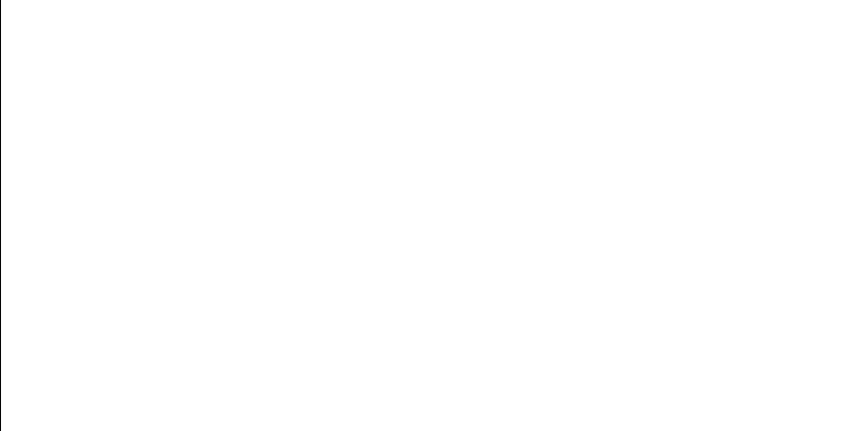

604.552053116 188.253316257
515.64354269 159.123232131
652.951446044 222.934135351
576.544747955 175.00559808
719.132940644 320.992986968
711.980405272 303.776552036
622.434753084 199.090615664
718.390086347 319.024963186
686.86228895 260.864362343
652.318481738 222.357958268


<IPython.core.display.Javascript object>

541.744477855 163.94268768
569.587275814 172.342771783
725.935570334 342.020087588
593.790037888 182.660503878
683.758532276 256.684499415
388.856555195 175.245830411
645.540036686 216.426023373
531.789299088 161.768116347
699.297759274 279.696947703
719.923133359 323.142974198


<IPython.core.display.Javascript object>

608.625375411 190.545736931
576.223448411 174.877406758
554.506930557 167.358201293
717.817989329 317.542294543
570.143148603 172.546893335
652.096095747 222.156454746
712.858526397 305.708868518
666.277649038 236.045371953
621.520466419 198.486151564
506.339728099 158.083166981


<IPython.core.display.Javascript object>

666.277649038 236.045371953
648.310009961 218.798526277
734.851639403 400.354091708
658.946847822 228.592941542
558.350632839 168.529040983
633.823035596 207.117826607
554.268250761 167.287699044
512.255080506 158.703894827
467.002739465 157.508275175
733.056133375 377.760119057


<IPython.core.display.Javascript object>


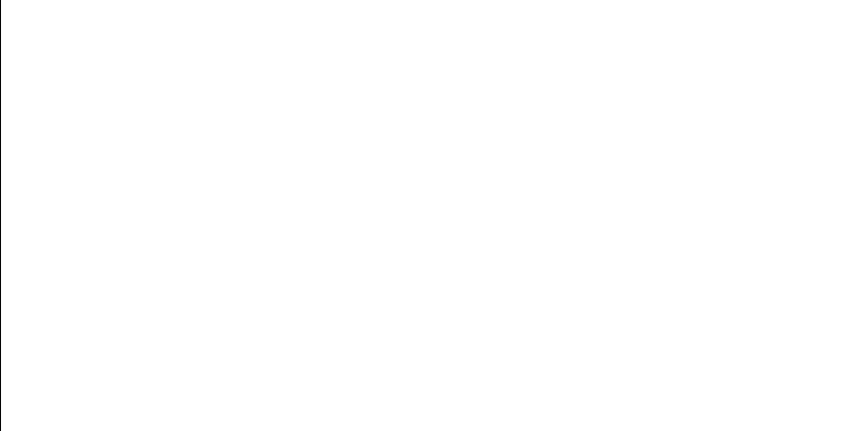

733.143185223 378.464989171
587.099245465 179.506324502
683.753029387 256.677246638
452.442250584 158.859591528
604.552053116 188.253316257
606.68270132 189.440009578
726.73526152 344.991232696
669.590220919 239.624413042
636.733305674 209.325087388
430.805958547 162.464440624


<IPython.core.display.Javascript object>

720.28181865 324.139299212
620.569023216 197.863163206
719.923133359 323.142974198
632.2291649 205.936816869
547.19172003 165.312858198
569.806335014 172.423035353
504.794242014 157.944207366
720.178048531 323.849701732
704.33633666 288.524998137
634.601612892 207.701835655


<IPython.core.display.Javascript object>

455.249808569 158.532583206
549.603980871 165.961094201
548.033709049 165.536210727
711.091936549 301.864252084
444.627766371 159.938618637
692.362953408 268.746109715
694.107515999 271.385986583
620.569023216 197.863163206
594.008227172 182.767434925
593.756845973 182.644259914


<IPython.core.display.Javascript object>

730.231742878 360.209987563
625.702676803 201.298420725
632.2291649 205.936816869
651.369743176 221.501654453
424.068480614 163.987600267
674.033292905 244.651951634
607.28661791 189.781304154
658.946847822 228.592941542
652.992536587 222.971675531
624.483148454 200.465785293


<IPython.core.display.Javascript object>

566.666674951 171.294536237
698.578546086 278.501377526
344.796148576 198.278156207
606.958126124 189.595389821
503.451387684 157.831250467
594.788727464 183.152085659
732.018340298 370.349434734
652.163732521 222.217689276
676.731151339 247.840945023
717.817989329 317.542294543


<IPython.core.display.Javascript object>

605.136693921 188.576253552
571.173824978 172.929297479
676.15034901 247.145303814
529.371455437 161.303233528
654.024669208 223.920118537
719.643282222 322.374617005
733.143185223 378.464989171
734.969739078 405.094799761
599.978689127 185.796088094
612.504992559 192.823088878


<IPython.core.display.Javascript object>

695.937111194 274.234326788
561.340313067 169.486335779
448.460860761 159.378190335
648.323059591 218.809868901
605.136693921 188.576253552
557.822362973 168.36414648
625.099455569 200.885260669
656.351196625 226.097395785
483.837761365 157.001392552
618.962976477 196.825380812


<IPython.core.display.Javascript object>

676.457709199 247.512803134
620.470624477 197.799082848
660.994906333 230.613303972
514.041505085 158.919163145
733.971382147 386.254333533
676.890570685 248.032777872
599.574634212 185.584793135
733.05542972 377.754487244
501.77175983 157.700137221
594.834335972 183.174666395


<IPython.core.display.Javascript object>

634.976074137 207.984396402
689.483763322 264.540817237
617.201780325 195.707050849
635.042740568 208.034816347
717.360304884 316.375772637
697.485018512 276.711766079
566.628248116 171.281014395
571.410767413 173.01793245
734.053869031 387.183610647
662.555598634 232.184313481


<IPython.core.display.Javascript object>

699.861303977 280.644342401
619.302905799 197.04359441
632.924437086 206.449603396
614.51349365 194.03907102
683.758532276 256.684499415
505.826037103 158.03591486
588.679905722 180.229902464
696.775114579 275.567618672
654.700305053 224.546739674
558.860126944 168.689282095


<IPython.core.display.Javascript object>

454.1423466 158.657762572
661.846288389 231.466890048
644.352388413 215.42984023
559.491406047 168.889473781
594.008227172 182.767434925
715.099995778 310.849136735
659.932896341 229.559898038
714.285747643 308.945500166
730.11378595 359.616026956
552.240977751 166.699180769


<IPython.core.display.Javascript object>

616.949494685 195.548523375
582.190359002 177.342337314
713.561022666 307.286604484
732.992621728 377.255881153
541.744477855 163.94268768
656.734068806 226.461036115
620.391752288 197.747765921
423.875480612 164.034101951
685.72489741 259.311603756
671.424480509 241.667351826


<IPython.core.display.Javascript object>

676.729552754 247.839023366
582.054111975 177.284046944
572.06290863 173.263286045
531.262327357 161.664705798
621.741156677 198.631534103
679.07736698 250.703865625
576.076820122 174.819075166
700.745479566 282.150064531
606.958126124 189.595389821
455.175599076 158.540816273


<IPython.core.display.Javascript object>

524.645478286 160.46498408
526.643694651 160.80808249
659.746212495 229.376013938
733.554038503 382.043112389
558.622589817 168.614426578
620.39544523 197.75016774
600.560879186 186.102176581
581.910485098 177.22270185
492.305481319 157.171868098
709.696337689 298.941967679


<IPython.core.display.Javascript object>

647.498031864 218.095842075
529.815357232 161.386748482
715.404307946 311.571884714
725.259801536 339.615646148
461.349508382 157.931769806
512.458349467 158.727736961
724.959441028 338.575367255
650.990350315 221.161659396
600.419652718 186.027748014
567.576676579 171.6167955


<IPython.core.display.Javascript object>

659.746212495 229.376013938
428.214449535 163.027352211
580.101276805 176.458945468
614.636921482 194.114633112
503.404990879 157.827476926
569.281661596 172.23117842
688.070739434 262.54184274
680.303399427 252.234670368
676.15034901 247.145303814
642.647490097 214.021337307


<IPython.core.display.Javascript object>

678.583495607 250.094064787
658.069990997 227.741901554
566.164422456 171.118351196
720.28181865 324.139299212
623.779563111 199.990156666
584.506112312 178.347644358
430.805958547 162.464440624
590.147738399 180.913695817
611.651150623 192.313864211
679.942391032 251.781379555


<IPython.core.display.Javascript object>

711.091936549 301.864252084
676.890570685 248.032777872
344.796148576 198.278156207
577.298006073 175.308138672
388.856555195 175.245830411
615.405530676 194.587371066
734.704505123 396.799913905
569.798730474 172.420245185
560.245556012 169.131027274
636.479646499 209.130047004


<IPython.core.display.Javascript object>

659.932896341 229.559898038
613.549142693 193.452043985
711.310092901 302.329941036
734.198534799 388.917766186
666.677172752 236.469723788
587.912751689 179.877075496
670.375921388 240.494023596
685.048799614 258.400257057
732.756271628 375.446985496
557.822362973 168.36414648


<IPython.core.display.Javascript object>

709.7004149 298.950366269
615.949587509 194.924295677
531.405226975 161.692632537
417.207705002 165.740110337
587.912751689 179.877075496
732.018340298 370.349434734
629.437084166 203.914212143
651.369743176 221.501654453
604.87975453 188.434079161
506.938700804 158.139603357


<IPython.core.display.Javascript object>

657.729178893 227.413342882
700.68048788 282.038568076
618.164286185 196.315689953
570.233052336 172.580046146
508.831196479 158.327406188
457.216053099 158.322541735
566.038132355 171.074237261
597.873447589 184.705347725
468.4964277 157.417714474
571.706885725 173.12908525


<IPython.core.display.Javascript object>

681.895868305 254.260109954
406.064776168 169.031311763
548.278164097 165.601640737
620.399671068 197.752916256
719.923133359 323.142974198
675.010686855 245.794926141
493.411828806 157.215183498
528.698475591 161.178190369
609.992672317 191.337735981
690.953805851 266.665132058


<IPython.core.display.Javascript object>

676.176691598 247.17674511
653.991797744 223.889748786
660.994906333 230.613303972
553.153803142 166.961895759
717.591971866 316.964100829
615.949587509 194.924295677
704.869759539 289.510210468
645.540036686 216.426023373
607.244091221 189.757198986
627.486893389 202.535626224


<IPython.core.display.Javascript object>

406.064776168 169.031311763
734.200389875 388.940983908
660.994906333 230.613303972
593.790037888 182.660503878
731.983131526 370.123268973
632.790789281 206.350747728
498.190602407 157.458262711
553.496800566 167.061575788
697.274345395 276.370799198
425.506059781 163.6462822


<IPython.core.display.Javascript object>

558.860126944 168.689282095
507.24757582 158.169270091
617.504132809 195.897587397
606.426791351 189.296046515
666.277649038 236.045371953
685.72489741 259.311603756
549.603980871 165.961094201
503.404990879 157.827476926
520.907682668 159.867489888
683.758532276 256.684499415


<IPython.core.display.Javascript object>

572.222500289 173.32364259
644.203715568 215.306009161
700.68048788 282.038568076
542.076296462 164.022467977
650.739871688 220.937947884
732.992621728 377.255881153
697.485018512 276.711766079
728.677052707 352.903781115
676.729552754 247.839023366
637.207566385 209.691127971


<IPython.core.display.Javascript object>

608.269563248 190.341507085
662.830626517 232.464038319
647.498031864 218.095842075
558.811222069 168.673849512
549.785275852 166.010850182
645.982930463 216.800717021
651.369743176 221.501654453
620.399671068 197.752916256
646.910089571 217.590798192
730.11378595 359.616026956


<IPython.core.display.Javascript object>

733.583760938 382.320817965
613.510255579 193.428496344
501.365541992 157.670123409
586.076415208 179.045107406
524.645478286 160.46498408
543.028675218 164.25409472
692.835419414 269.453961865
390.89942369 174.433412773
671.775126876 242.063031437
734.200389875 388.940983908


<IPython.core.display.Javascript object>

598.268327969 184.908026545
483.894568765 157.001587809
674.033292905 244.651951634
706.039365503 291.707879906
647.811710458 218.366581902
545.19276935 164.795046241
711.091936549 301.864252084
682.426381351 254.944430736
685.048799614 258.400257057
732.379765436 372.754550756


<IPython.core.display.Javascript object>

568.388463583 171.90759125
487.930669 157.048241714
641.212008774 212.854746987
606.426791351 189.296046515
662.555598634 232.184313481
570.705535266 172.754917334
594.281406721 182.901683955
734.953108424 404.138811292
486.011192701 157.01799128
526.936178283 160.859692436


<IPython.core.display.Javascript object>

666.982651069 236.795516593
649.308154098 219.670662916
612.504992559 192.823088878
566.847870801 171.358390507
416.855652256 165.835600341
657.306053938 227.007144204
670.375921388 240.494023596
690.681912685 266.268703
672.501993058 242.888607774
592.911052304 182.232364343


<IPython.core.display.Javascript object>

457.200645851 158.324126958
636.733305674 209.325087388
476.435537547 157.085514841
601.536255422 186.619344028
692.835419414 269.453961865
676.731151339 247.840945023
604.87975453 188.434079161
637.523915348 209.936292646
556.807777182 168.051017791
687.445413157 261.670189578


<IPython.core.display.Javascript object>

652.248702388 222.294679401
640.049027487 211.922342805
702.150779831 284.593666964
701.276491918 283.065997142
632.924437086 206.449603396
498.614675495 157.484231291
422.235746039 164.435682405
681.984988414 254.374729149
656.815703225 226.538767645
733.346638124 380.180548579


<IPython.core.display.Javascript object>

668.949069763 238.920773008
641.871450862 213.388491901
678.165554736 249.581035492
612.872651672 193.043767518
468.55569541 157.414304729
652.992536587 222.971675531
611.165196839 192.026079173
534.095197546 162.234360601
733.896528812 385.443008896
718.390086347 319.024963186


<IPython.core.display.Javascript object>

670.459323691 240.586811795
675.515983516 246.391279168
670.459323691 240.586811795
691.514147601 267.487278839
715.404307946 311.571884714
665.323501111 235.039829436
453.744508908 158.703942818
580.192387775 176.497011291
411.638133026 167.315321251
598.268327969 184.908026545


<IPython.core.display.Javascript object>

599.978689127 185.796088094
530.10934563 161.442512627
606.32198023 189.237197888
571.470397506 173.040281478
665.506545919 235.231876638
676.890570685 248.032777872
693.363345 270.251078994
619.302905799 197.04359441
724.96034934 338.578488036
676.731151339 247.840945023


<IPython.core.display.Javascript object>

577.298006073 175.308138672
684.019058843 257.028496152
676.731151339 247.840945023
613.610480973 193.489206164
642.510277722 213.909069147
614.636921482 194.114633112
493.411828806 157.215183498
558.758163057 168.657118412
581.116765406 176.88558781
722.293019178 329.988285853


<IPython.core.display.Javascript object>

726.516009318 344.162100545
734.198534799 388.917766186
642.827410297 214.168793779
537.222167755 162.902546694
615.979100929 194.942627513
719.230351892 321.254795886
452.442250584 158.859591528
732.756271628 375.446985496
573.333430952 173.747218396
714.648701186 309.788714156


<IPython.core.display.Javascript object>

680.405596131 252.363380347
625.202760813 200.955834455
503.918593653 157.869730141
622.47337936 199.11627874
528.229291628 161.092131672
515.50862192 159.105643319
716.988113621 315.439523922
633.820931434 207.116254638
714.198232262 308.743442116
657.574111081 227.264258495


<IPython.core.display.Javascript object>

675.010686855 245.794926141
594.110279251 182.8175386
580.047852159 176.43664435
647.457915569 218.061282065
678.165554736 249.581035492
565.822552416 170.999107541
607.28661791 189.781304154
613.445960439 193.389584191
731.983131526 370.123268973
724.989915746 338.680154455


<IPython.core.display.Javascript object>

483.189665661 157.000071375
701.146564342 282.841066643
654.112055162 224.000906547
440.573477222 160.597121263
694.107515999 271.385986583
669.629955889 239.66819683
654.426174145 224.291941654
448.460860761 159.378190335
730.009611696 359.097577919
580.047852159 176.43664435


<IPython.core.display.Javascript object>

558.758163057 168.657118412
507.24757582 158.169270091
541.725366965 163.938107257
699.297759274 279.696947703
686.86228895 260.864362343
589.220641864 180.480470765
583.753972392 178.018102339
488.689106878 157.064226314
473.732290186 157.170475212
660.994906333 230.613303972


<IPython.core.display.Javascript object>

607.10737018 189.679775974
686.907982322 260.927265354
692.362953408 268.746109715
546.844642137 165.221695653
719.139296261 321.010041702
681.895868305 254.260109954
712.965056596 305.946262829
627.486893389 202.535626224
669.189194472 239.183676103
719.471816626 321.907635573


<IPython.core.display.Javascript object>

523.969841853 160.352715562
576.076820122 174.819075166
729.631964287 357.263415344
734.998462899 408.119831524
566.666674951 171.294536237
484.134067442 157.002551816
382.470772347 177.920199092
659.746212495 229.376013938
701.276491918 283.065997142
570.367751581 172.629790406


<IPython.core.display.Javascript object>

717.591971866 316.964100829
708.154231473 295.820620033
617.570115183 195.939247866
615.949587509 194.924295677
720.792603049 325.581309437
557.013120764 168.114014615
650.121993575 220.388655528
725.935570334 342.020087588
577.05262511 175.209273687
529.815357232 161.386748482


<IPython.core.display.Javascript object>

448.460860761 159.378190335
611.165196839 192.026079173
605.455685964 188.753308822
685.72489741 259.311603756
595.278249354 183.395047213
698.253153538 277.965348507
592.722497181 182.14107112
430.805958547 162.464440624
524.407237585 160.42518093
556.807777182 168.051017791


<IPython.core.display.Javascript object>

597.873447589 184.705347725
652.073959692 222.136423682
406.064776168 169.031311763
700.68048788 282.038568076
575.238847174 174.487750699
571.173824978 172.929297479
734.953108424 404.138811292
682.426381351 254.944430736
634.666303489 207.750571712
569.281661596 172.23117842


<IPython.core.display.Javascript object>

501.77175983 157.700137221
675.819421302 246.751207188
653.148104611 223.113952925
664.284209501 233.957047027
682.770145533 255.390465942
522.435476116 160.104754518
657.817194387 227.498075639
719.639820779 322.365161617
552.240977751 166.699180769
594.110279251 182.8175386


<IPython.core.display.Javascript object>

455.175599076 158.540816273
719.230351892 321.254795886
716.164727111 313.40601467
537.222167755 162.902546694
620.391752288 197.747765921
567.576676579 171.6167955
659.4993603 229.133449986
700.745479566 282.150064531
606.32198023 189.237197888
666.718756233 236.514004603


<IPython.core.display.Javascript object>

668.949069763 238.920773008
498.614675495 157.484231291
709.486396073 298.51057791
636.448237874 209.105932321
722.196164919 329.695556945
620.391752288 197.747765921
458.76825405 158.167740336
572.06290863 173.263286045
660.104414725 229.729181725
618.627294943 196.610647945


<IPython.core.display.Javascript object>

675.88347178 246.827356456
701.696193679 283.796266548
570.367751581 172.629790406
716.988113621 315.439523922
734.753168004 397.849107669
499.344815047 157.530624089
419.211121546 165.207098164
688.070739434 262.54184274
656.812925222 226.536121313
580.288951833 176.537401178


<IPython.core.display.Javascript object>

569.806335014 172.423035353
612.872651672 193.043767518
733.346638124 380.180548579
515.648181365 159.123838165
685.048799614 258.400257057
571.173824978 172.929297479
709.488427876 298.514742892
667.474973324 237.323023626
715.956774816 312.90035865
720.427871688 324.548796658


<IPython.core.display.Javascript object>

599.978689127 185.796088094
458.76825405 158.167740336
647.457915569 218.061282065
683.097340504 255.816925468
385.250152418 176.730830075
530.893465121 161.593015461
387.977441929 175.601813508
582.054111975 177.284046944
539.616596856 163.442346972
719.053456389 320.780015152


<IPython.core.display.Javascript object>

649.744056299 220.054453112
660.104414725 229.729181725
452.902712915 158.803770392
570.233052336 172.580046146
721.115937726 326.50878713
556.807777182 168.051017791
726.633972309 344.606774139
620.39544523 197.75016774
598.008884768 184.774764078
584.582389272 178.381227586


<IPython.core.display.Javascript object>

406.064776168 169.031311763
576.076820122 174.819075166
688.710943769 263.44242509
420.858489739 164.781997587
566.666674951 171.294536237
666.677172752 236.469723788
676.15034901 247.145303814
582.054111975 177.284046944
680.405596131 252.363380347
719.639820779 322.365161617


<IPython.core.display.Javascript object>

530.10934563 161.442512627
541.692866623 163.930321322
725.637696749 340.948930088
632.677697761 206.26720346
586.188588721 179.095421625
560.72413158 169.285671329
705.075430073 289.892891237
595.103828241 183.308326043
428.214449535 163.027352211
570.233052336 172.580046146


<IPython.core.display.Javascript object>

655.167336031 224.982586683
615.70477196 194.772449253
541.933599992 163.988100713
614.092010181 193.781773851
734.297553363 390.197349292
645.928311383 216.754413965
423.875480612 164.034101951
641.212008774 212.854746987
648.859233778 219.277269231
680.952144759 253.054662187


<IPython.core.display.Javascript object>

733.066669 377.844566199
679.194643154 250.849242817
592.508187101 182.037542845
734.985028221 406.253083082
734.060032824 387.254657545
694.856048611 272.541161272
553.877094815 167.172711568
722.738644062 331.350901206
344.796148576 198.278156207
671.424480509 241.667351826


<IPython.core.display.Javascript object>

722.196164919 329.695556945
638.287023233 210.531008933
731.983131526 370.123268973
681.895868305 254.260109954
724.858526238 338.229573365
613.113358249 193.18870742
615.745486303 194.797675395
647.890540545 218.434762774
734.200389875 388.940983908
711.310092901 302.329941036


<IPython.core.display.Javascript object>

428.192826002 163.032169424
670.98864841 241.177867762
444.627766371 159.938618637
656.812925222 226.536121313
379.617893588 179.182376494
731.329297296 366.14489407
645.982930463 216.800717021
608.269563248 190.341507085
506.198152834 158.070038248
620.327997707 197.706315651


<IPython.core.display.Javascript object>

605.906429776 189.004523866
733.346638124 380.180548579
448.460860761 159.378190335
645.928311383 216.754413965
701.696193679 283.796266548
636.745745186 209.334665409
700.698119717 282.068803395
611.130392223 192.005524059
617.570115183 195.939247866
698.591505899 278.522789023


<IPython.core.display.Javascript object>

568.546140904 171.964437739
721.115937726 326.50878713
597.638293598 184.585068142
724.941873857 338.515039375
708.154231473 295.820620033
687.003339969 261.058669461
551.022873875 166.354397052
659.932896341 229.559898038
642.510277722 213.909069147
715.404307946 311.571884714


<IPython.core.display.Javascript object>

640.049027487 211.922342805
595.231524773 183.371799531
608.625375411 190.545736931
654.083433296 223.974437302
608.978101667 190.748956703
641.755664159 213.294509281
653.991797744 223.889748786
604.159770194 188.037763212
629.437084166 203.914212143
558.811222069 168.673849512


<IPython.core.display.Javascript object>

584.506112312 178.347644358
712.915575824 305.835917134
624.483148454 200.465785293
733.971382147 386.254333533
688.739431879 263.482694602
546.844642137 165.221695653
626.079863057 201.558073698
631.466365002 205.378443029
730.639366804 362.322982007
579.41662835 176.174241593


<IPython.core.display.Javascript object>

730.11378595 359.616026956
644.352388413 215.42984023
701.789243043 283.958938229
548.701619741 165.715604357
732.018340298 370.349434734
686.86228895 260.864362343
531.789299088 161.768116347
577.298006073 175.308138672
701.696193679 283.796266548
511.829492583 158.654518001


<IPython.core.display.Javascript object>

554.506930557 167.358201293
647.498031864 218.095842075
656.815703225 226.538767645
600.560879186 186.102176581
428.214449535 163.027352211
503.918593653 157.869730141
665.323501111 235.039829436
679.07736698 250.703865625
704.33633666 288.524998137
652.096095747 222.156454746


<IPython.core.display.Javascript object>

593.756845973 182.644259914
606.32198023 189.237197888
531.720366249 161.754522968
685.721251977 259.306666826
587.502445946 179.689645259
425.032309608 163.757779184
734.672420641 396.15505202
645.928311383 216.754413965
593.756845973 182.644259914
711.980405272 303.776552036


<IPython.core.display.Javascript object>

603.59103321 187.726859494
580.288951833 176.537401178
679.106434221 250.739877237
553.877094815 167.172711568
551.022873875 166.354397052
522.106560984 160.052863266
473.732290186 157.170475212
515.50862192 159.105643319
649.636473611 219.959566065
571.706885725 173.12908525


<IPython.core.display.Javascript object>

701.125601727 282.804826276
560.245556012 169.131027274
693.445282086 270.375387295
549.785275852 166.010850182
649.308154098 219.670662916
691.514147601 267.487278839
730.009611696 359.097577919
732.756271628 375.446985496
710.529681842 300.675284995
696.07214895 274.447930741


<IPython.core.display.Javascript object>

611.983506644 192.511536072
524.911240127 160.509662258
687.606330017 261.893746846
633.820931434 207.116254638
624.617354014 200.556902148
591.070096526 181.34927139
665.78119945 235.52079915
620.470624477 197.799082848
690.953805851 266.665132058
733.583794391 382.321132175


<IPython.core.display.Javascript object>

621.741156677 198.631534103
435.075735699 161.598979608
430.260841215 162.580477375
689.757650359 264.933091871
713.259816063 306.606557306
621.520466419 198.486151564
649.462734458 219.806559213
424.068480614 163.987600267
597.638293598 184.585068142
734.12517036 388.020276172


<IPython.core.display.Javascript object>

520.907682668 159.867489888
732.40000167 372.894056346
546.844642137 165.221695653
485.203360907 157.009632722
701.696193679 283.796266548
556.61612505 167.992394036
674.205443272 244.852266348
594.834335972 183.174666395
682.770145533 255.390465942
724.989915746 338.680154455


<IPython.core.display.Javascript object>

598.124275422 184.833987392
640.049027487 211.922342805
708.626851292 296.765762906
561.340313067 169.486335779
697.274345395 276.370799198
678.165554736 249.581035492
680.303399427 252.234670368
687.445413157 261.670189578
652.073959692 222.136423682
606.68270132 189.440009578


<IPython.core.display.Javascript object>

659.932896341 229.559898038
712.915575824 305.835917134
656.812925222 226.536121313
649.636473611 219.959566065
551.022873875 166.354397052
719.807952736 322.825795501
457.216053099 158.322541735
379.617893588 179.182376494
630.301558976 204.534230926
690.681912685 266.268703


<IPython.core.display.Javascript object>

660.147853878 229.772106338
571.173824978 172.929297479
659.549750831 229.182911041
611.651150623 192.313864211
558.622589817 168.614426578
554.506930557 167.358201293
644.768870714 215.777764044
654.10401716 223.993472245
604.137968588 188.025810181
645.540036686 216.426023373


<IPython.core.display.Javascript object>

693.580902921 270.581492116
668.507149345 238.438874471
580.101276805 176.458945468
601.085292753 186.379552522
608.269563248 190.341507085
692.881062962 269.522620436
712.187153015 304.22763297
539.616596856 163.442346972
613.113358249 193.18870742
553.153803142 166.961895759


<IPython.core.display.Javascript object>

565.822552416 170.999107541
649.592351581 219.920682266
579.345244916 176.144693464
548.830947137 165.750567526
514.558810004 158.983917495
524.407237585 160.42518093
631.265072906 205.231827421
520.907682668 159.867489888
646.721532417 217.429491249
611.864390438 192.440611201


<IPython.core.display.Javascript object>

649.636473611 219.959566065
630.16686333 204.437260632
416.855652256 165.835600341
568.152504433 171.822743526
638.287023233 210.531008933
615.405530676 194.587371066
707.893967403 295.304338579
631.238249846 205.212313221
560.098605828 169.083754241
719.643282222 322.374617005


<IPython.core.display.Javascript object>

566.666674951 171.294536237
579.41662835 176.174241593
689.396150139 264.415667489
683.753029387 256.677246638
689.101351754 263.99574901
638.072447358 210.363306334
582.054111975 177.284046944
683.139011014 255.871373447
701.133420324 282.818341517
700.667932514 282.017043839


<IPython.core.display.Javascript object>

537.222167755 162.902546694
657.574111081 227.264258495
726.516009318 344.162100545
543.84964908 164.456915439
645.928311383 216.754413965
733.143185223 378.464989171
734.672420641 396.15505202
615.949587509 194.924295677
634.223543225 207.417659567
726.633972309 344.606774139


<IPython.core.display.Javascript object>

670.375921388 240.494023596
711.37282435 302.464310683
675.010686855 245.794926141
700.667932514 282.017043839
470.062492153 157.332320528
608.625375411 190.545736931
648.624506066 219.072321684
683.412176555 256.229062029
565.822552416 170.999107541
498.614675495 157.484231291


<IPython.core.display.Javascript object>

657.306053938 227.007144204
574.870216398 174.343094415
662.481501163 232.109099329
559.819270244 168.994167323
421.961468474 164.503992529
545.924713291 164.982622633
662.236643359 231.860998994
675.515983516 246.391279168
730.231742878 360.209987563
520.907682668 159.867489888


<IPython.core.display.Javascript object>

615.979100929 194.942627513
689.101351754 263.99574901
603.674018331 187.772105511
581.116765406 176.88558781
665.323501111 235.039829436
631.265072906 205.231827421
676.176691598 247.17674511
646.553557557 217.286062556
469.769901278 157.347532323
566.038132355 171.074237261


<IPython.core.display.Javascript object>

581.431831642 177.019021212
604.159770194 188.037763212
503.404990879 157.827476926
557.592787166 168.292883149
734.850109024 400.309626907
734.704505123 396.799913905
719.899766439 323.078520374
468.55569541 157.414304729
594.008227172 182.767434925
701.146564342 282.841066643


<IPython.core.display.Javascript object>

657.729178893 227.413342882
551.559435248 166.505456064
637.523915348 209.936292646
724.858526238 338.229573365
681.435533481 253.670224837
605.136693921 188.576253552
523.969841853 160.352715562
634.976074137 207.984396402
553.877094815 167.172711568
692.45253046 268.879917628


<IPython.core.display.Javascript object>

603.59103321 187.726859494
607.10737018 189.679775974
710.731140761 301.099455387
604.87975453 188.434079161
647.890540545 218.434762774
673.254742059 243.751299176
604.87975453 188.434079161
714.198232262 308.743442116
647.890540545 218.434762774
724.96034934 338.578488036


<IPython.core.display.Javascript object>

616.64384202 195.357018626
715.786122766 312.487715562
707.623071879 294.770075815
691.514147601 267.487278839
567.576676579 171.6167955
719.230351892 321.254795886
525.254813675 160.567854895
449.072188158 159.294366136
559.491406047 168.889473781
551.427639815 166.468232783


<IPython.core.display.Javascript object>

559.819270244 168.994167323
524.645478286 160.46498408
712.086913033 304.008637132
672.140026088 242.476576629
515.50862192 159.105643319
587.099245465 179.506324502
683.097340504 255.816925468
585.622259308 178.842071841
616.97005164 195.561425081
618.945944419 196.814467515


<IPython.core.display.Javascript object>

681.049121885 253.177840727
590.147738399 180.913695817
523.106167105 160.21194691
629.942621281 204.27612242
712.858526397 305.708868518
578.146342757 175.652247793
653.680141429 223.602348122
620.39544523 197.75016774
726.458242222 343.945528255
673.538146661 244.078155883


<IPython.core.display.Javascript object>

701.125601727 282.804826276
659.4993603 229.133449986
674.498197807 245.193894385
645.928311383 216.754413965
692.07159451 268.312159839
416.855652256 165.835600341
704.869759539 289.510210468
512.255080506 158.703894827
690.535418347 266.05577965
506.198152834 158.070038248


<IPython.core.display.Javascript object>

701.146564342 282.841066643
644.530886737 215.578768926
634.601612892 207.701835655
730.009611696 359.097577919
630.16686333 204.437260632
712.694004114 305.343526617
558.622589817 168.614426578
704.722233206 289.236686326
633.288627802 206.719678779
659.746212495 229.376013938


<IPython.core.display.Javascript object>

724.989915746 338.680154455
662.129458601 231.752610566
625.702676803 201.298420725
483.189665661 157.000071375
648.054855265 218.577063479
594.008227172 182.767434925
651.300788186 221.439757156
605.136693921 188.576253552
665.506545919 235.231876638
711.980405272 303.776552036


<IPython.core.display.Javascript object>

654.700305053 224.546739674
719.639820779 322.365161617
557.822362973 168.36414648
629.492001155 203.953435538
685.72489741 259.311603756
666.393880218 236.168623512
730.661055827 362.438197773
480.32480143 157.014200177
586.188588721 179.095421625
667.168348779 236.994130019


<IPython.core.display.Javascript object>

678.583495607 250.094064787
489.785304162 157.091366469
693.580902921 270.581492116
442.517278956 160.27294217
679.106434221 250.739877237
615.150087408 194.429838053
581.431831642 177.019021212
529.371455437 161.303233528
580.192387775 176.497011291
730.231742878 360.209987563


<IPython.core.display.Javascript object>

726.73526152 344.991232696
657.265866957 226.9686631
614.636921482 194.114633112
725.391294517 340.076416646
589.201932133 180.471775023
390.89942369 174.433412773
662.815321407 232.448448924
709.486396073 298.51057791
498.614675495 157.484231291
457.200645851 158.324126958


<IPython.core.display.Javascript object>

670.375921388 240.494023596
493.411828806 157.215183498
662.129458601 231.752610566
611.165196839 192.026079173
615.405530676 194.587371066
567.522121258 171.597365183
665.323501111 235.039829436
678.583495607 250.094064787
631.466365002 205.378443029
452.442250584 158.859591528


<IPython.core.display.Javascript object>

711.091936549 301.864252084
646.829347598 217.521685652
697.274345395 276.370799198
690.681912685 266.268703
567.418382531 171.560456767
713.259816063 306.606557306
674.033292905 244.651951634
730.231742878 360.209987563
734.12517036 388.020276172
618.962976477 196.825380812


<IPython.core.display.Javascript object>

657.574111081 227.264258495
719.923133359 323.142974198
719.639820779 322.365161617
716.969152177 315.392116627
503.482569956 157.833791429
558.811222069 168.673849512
572.06290863 173.263286045
589.201932133 180.471775023
666.718756233 236.514004603
550.150464214 166.111517038


<IPython.core.display.Javascript object>

483.837761365 157.001392552
687.445413157 261.670189578
641.345583362 212.962564214
507.24757582 158.169270091
388.856555195 175.245830411
581.431831642 177.019021212
704.869759539 289.510210468
711.980405272 303.776552036
646.829347598 217.521685652
726.516009318 344.162100545


<IPython.core.display.Javascript object>

655.167336031 224.982586683
727.028130684 346.11700202
645.540036686 216.426023373
572.754166002 173.525607156
661.846288389 231.466890048
590.147738399 180.913695817
660.239069318 229.862309082
574.870216398 174.343094415
734.672420641 396.15505202
507.24757582 158.169270091


<IPython.core.display.Javascript object>

676.176691598 247.17674511
690.681912685 266.268703
725.967005522 342.134207343
714.648701186 309.788714156
526.643694651 160.80808249
692.835419414 269.453961865
733.554038503 382.043112389
658.946847822 228.592941542
734.969739078 405.094799761
459.26108437 158.120618853


<IPython.core.display.Javascript object>

657.574111081 227.264258495
574.599193025 174.237166832
709.488427876 298.514742892
508.831196479 158.327406188
726.633972309 344.606774139
550.150464214 166.111517038
644.203715568 215.306009161
574.870216398 174.343094415
667.474973324 237.323023626
700.801561568 282.246381595


<IPython.core.display.Javascript object>

620.470624477 197.799082848
557.956069781 168.405761492
701.519604776 283.48831796
725.685408821 341.119278545
483.837761365 157.001392552
705.647413671 290.965559325
650.990350315 221.161659396
605.455685964 188.753308822
595.103828241 183.308326043
682.875071758 255.527019675


<IPython.core.display.Javascript object>

701.789243043 283.958938229
586.188588721 179.095421625
573.480620763 173.803789856
607.284891398 189.780325312
666.277649038 236.045371953
415.505670824 166.206846206
560.72413158 169.285671329
422.065949255 164.477932571
501.365541992 157.670123409
655.109457255 224.928452162


<IPython.core.display.Javascript object>

718.487092244 319.279158573
459.26108437 158.120618853
719.821273823 322.86241085
659.4993603 229.133449986
573.296972556 173.733222177
426.123332237 163.502454871
642.010344464 213.501380175
637.841722455 210.183398613
620.391752288 197.747765921
712.187153015 304.22763297


<IPython.core.display.Javascript object>

595.809535549 183.660237221
566.666674951 171.294536237
667.615757994 237.474427853
432.182475024 162.177028712
616.949494685 195.548523375
632.790789281 206.350747728
620.569023216 197.863163206
350.261343605 194.793442915
636.745745186 209.334665409
641.755664159 213.294509281


<IPython.core.display.Javascript object>

594.008227172 182.767434925
661.821475232 231.441896845
644.352388413 215.42984023
531.405226975 161.692632537
720.178048531 323.849701732
430.260841215 162.580477375
548.278164097 165.601640737
446.74875257 159.621077355
580.047852159 176.43664435
657.695115909 227.380572411


<IPython.core.display.Javascript object>

693.269441471 270.108812434
518.093157428 159.45547431
519.375015315 159.639100377
709.7004149 298.950366269
568.152504433 171.822743526
713.32981944 306.764124316
541.933599992 163.988100713
382.470772347 177.920199092
541.744477855 163.94268768
685.72489741 259.311603756


<IPython.core.display.Javascript object>

557.592787166 168.292883149
552.240977751 166.699180769
708.154231473 295.820620033
713.561022666 307.286604484
508.207589283 158.263928717
644.530886737 215.578768926
681.984988414 254.374729149
364.64287017 186.523956754
692.362953408 268.746109715
520.907682668 159.867489888


<IPython.core.display.Javascript object>

699.861303977 280.644342401
734.969739078 405.094799761
723.092671157 332.452568581
529.366982144 161.302396122
599.978689127 185.796088094
637.207566385 209.691127971
611.165196839 192.026079173
537.222167755 162.902546694
642.286515739 213.726330746
579.110600178 176.047746237


<IPython.core.display.Javascript object>

665.323501111 235.039829436
678.173645423 249.590940871
560.245556012 169.131027274
601.085292753 186.379552522
698.369551977 278.15674996
713.259816063 306.606557306
615.162032521 194.437195302
688.576598745 263.252746001
700.667932514 282.017043839
734.924489278 402.831393819


<IPython.core.display.Javascript object>

616.502928945 195.268935428
492.305481319 157.171868098
652.992536587 222.971675531
734.060032824 387.254657545
504.794242014 157.944207366
641.871450862 213.388491901
611.130392223 192.005524059
688.739431879 263.482694602
691.514147601 267.487278839
575.255940617 174.494474647


<IPython.core.display.Javascript object>

680.303399427 252.234670368
647.498031864 218.095842075
683.201172028 255.952652037
661.846288389 231.466890048
637.207566385 209.691127971
683.412176555 256.229062029
592.911052304 182.232364343
503.918593653 157.869730141
734.200389875 388.940983908
637.207566385 209.691127971


<IPython.core.display.Javascript object>

508.207589283 158.263928717
722.196164919 329.695556945
669.629955889 239.66819683
719.139296261 321.010041702
388.856555195 175.245830411
725.967005522 342.134207343
620.569023216 197.863163206
734.953108424 404.138811292
631.466365002 205.378443029
605.906429776 189.004523866


<IPython.core.display.Javascript object>

588.426506358 180.113015317
717.591971866 316.964100829
421.976122109 164.50033471
592.508187101 182.037542845
588.679905722 180.229902464
641.098867597 212.76354043
734.200389875 388.940983908
720.28181865 324.139299212
644.768870714 215.777764044
733.583760938 382.320817965


<IPython.core.display.Javascript object>

523.89710511 160.340741589
734.763731822 398.090218194
675.819421302 246.751207188
537.222167755 162.902546694
461.349508382 157.931769806
734.198534799 388.917766186
652.096095747 222.156454746
566.439764087 171.214790685
734.672420641 396.15505202
649.592351581 219.920682266


<IPython.core.display.Javascript object>

636.745745186 209.334665409
715.233793966 311.166136026
576.223448411 174.877406758
613.417894968 193.37260686
666.607575647 236.395660063
693.311152364 270.171979804
686.2516707 260.027659085
490.979981623 157.126381109
487.930669 157.048241714
608.269563248 190.341507085


<IPython.core.display.Javascript object>

703.155466514 286.380382629
721.115937726 326.50878713
637.841722455 210.183398613
671.010534603 241.20238715
734.851639403 400.354091708
604.87975453 188.434079161
602.384074203 187.073339081
566.628248116 171.281014395
546.844642137 165.221695653
603.59103321 187.726859494


<IPython.core.display.Javascript object>

726.885994796 345.567976997
686.86228895 260.864362343
576.25812998 174.891219317
693.363345 270.251078994
585.622259308 178.842071841
430.260841215 162.580477375
467.112240618 157.501333797
693.958396457 271.157499427
733.681177945 383.252242352
604.137968588 188.025810181


<IPython.core.display.Javascript object>

625.702676803 201.298420725
711.37282435 302.464310683
704.869759539 289.510210468
490.979981623 157.126381109
534.095197546 162.234360601
522.427273526 160.103455021
725.935570334 342.020087588
659.549750831 229.182911041
572.754166002 173.525607156
618.945944419 196.814467515


<IPython.core.display.Javascript object>

629.437084166 203.914212143
674.033292905 244.651951634
633.823035596 207.117826607
684.678582519 257.904833455
661.108746193 230.726966342
452.902712915 158.803770392
734.704505123 396.799913905
589.220641864 180.480470765
587.470190403 179.674948344
653.991797744 223.889748786


<IPython.core.display.Javascript object>

672.620329317 243.023704374
710.731140761 301.099455387
585.622259308 178.842071841
719.923133359 323.142974198
700.745479566 282.150064531
593.790037888 182.660503878
700.801561568 282.246381595
644.203715568 215.306009161
695.937111194 274.234326788
640.049027487 211.922342805


<IPython.core.display.Javascript object>

683.758532276 256.684499415
528.229291628 161.092131672
595.462960962 183.487068194
717.591971866 316.964100829
733.681177945 383.252242352
701.696193679 283.796266548
695.937111194 274.234326788
551.022873875 166.354397052
582.224842198 177.357105244
652.096095747 222.156454746


<IPython.core.display.Javascript object>

624.791928844 200.67561613
529.371455437 161.303233528
484.134067442 157.002551816
654.112055162 224.000906547
536.457190969 162.735246668
605.906429776 189.004523866
658.069990997 227.741901554
561.340313067 169.486335779
654.10401716 223.993472245
586.216777267 179.10807563


<IPython.core.display.Javascript object>

605.993014054 189.052918879
502.308930381 157.74084055
707.623071879 294.770075815
683.139011014 255.871373447
451.504493638 158.975935
503.451387684 157.831250467
734.060032824 387.254657545
633.056946071 206.547751467
681.035118777 253.160044498
684.019058843 257.028496152


In [7]:
condition_list = ['cognitive', 'pain', 'vicarious']
for ind, condition in enumerate(condition_list):
    low_dir = os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'scl'])

    if os.path.exists(low_dir): # if low_dir exists, wipe out every stimuli
        shutil.rmtree(low_dir) # we don't want multiple high cues than intended

    if not os.path.exists(low_dir):
        os.makedirs(low_dir)

    x0, y0 = 0.5, 0.5
    r = 252
    centerX = 483
    centerY = 409

    sample_data = pd.DataFrame()
    for fignum in range(1,57):

        # Read Images 
        plt.cla()
        img_scale = os.sep.join([main_dir, 'stimuli', 'ratingscale', 'task-'+ condition + '_scale.png'])
        display_image_in_actual_size(img_scale)

        # sample 10 radians
        high_sample = []
        high_sample = abs(np.random.choice(high_dist, 10, replace=True))
        # add sample to pd dataframe
        col_name = []
        col_name = 'figure' + '{:03d}'.format(fignum)
        sample_data[col_name] = high_sample

        for rad in range(10):
            if high_sample[rad]/pi > 1:
                # if the radians goes off the circular rating chart, 
                # flip the radians so that it's within the range of the circular rating image
                high_sample[rad] = (1 - (high_sample[rad]/pi-1))*pi
                x = centerX + r * cos(high_sample[rad])
                y = centerY - r * sin(high_sample[rad])
            else:
                x = centerX + r * cos(high_sample[rad])
                y = centerY - r * sin(high_sample[rad])
            print x,y
            plt.scatter( x,y,s=15**2, c='white', alpha=0.5, edgecolors='black', linewidths=.5)

        # calculate sample mean
        file_mean_original = np.mean(high_sample)
        file_mean_round = '{:.2f}'.format(round(file_mean_original, 2))
        file_mean = str(file_mean_round).replace(".", "")
        # calculate sample std
        file_std_original = np.std(high_sample)
        file_std_round = '{:.2f}'.format(round(file_std_original, 2))
        file_std = str(file_std_round).replace(".", "")
        # save image
        file_name = 'h' + '{:03d}'.format(fignum) + '_M' + str(file_mean) + '_STD'+ str(file_std) + '.png'
        file_fullname = os.path.join(low_dir, file_name)
        plt.savefig(file_fullname)

    # save pd dataframe
    sample_data.rename(index={0:'s01',1:'s02',2:'s03',3:'s04',4:'s05',5:'s06',6:'s07',7:'s08',8:'s09',9:'s10'}, inplace=True) 
    sample_data.loc['sample_mean'] = sample_data.mean()
    sample_data.loc['sample_std'] = sample_data.std()
    sample_data.to_csv(os.sep.join([main_dir, 'stimuli', 'cue', 'task-'+ condition, 'scl_data.csv']))